Using `ECOv002-CMR` package to retrieve ECOSTRESS granules as inputs using the Common Metadata Repository (CMR) API. Using `ECOv002-L2T-STARS` package to run the product generating executable (PGE).

In [1]:
import numpy as np
from ECOv002_CMR import download_ECOSTRESS_granule
from ECOv003_L2T_STARS import generate_L2T_STARS_runconfig, L2T_STARS

Disable logger output in notebook

In [2]:
import logging

logging.getLogger().handlers = []

Set working directory

In [3]:
working_directory = "~/data/ECOSTRESS_demo"

Retrieve LST LSTE granule from CMR API for target date

In [4]:
L2T_LSTE_granule = download_ECOSTRESS_granule(
    product="L2T_LSTE", 
    orbit=35800,
    scene=3,
    tile="11SPS", 
    aquisition_date="2024-10-29",
    parent_directory=working_directory
)

L2T_LSTE_granule

--2024-11-26 15:39:31--  https://data.lpdaac.earthdatacloud.nasa.gov/lp-prod-protected/ECO_L2T_LSTE.002/ECOv002_L2T_LSTE_35800_003_11SPS_20241029T075947_0713_01/ECOv002_L2T_LSTE_35800_003_11SPS_20241029T075947_0713_01_water.tif
Resolving data.lpdaac.earthdatacloud.nasa.gov (data.lpdaac.earthdatacloud.nasa.gov)... 18.154.144.127, 18.154.144.29, 18.154.144.87, ...
Connecting to data.lpdaac.earthdatacloud.nasa.gov (data.lpdaac.earthdatacloud.nasa.gov)|18.154.144.127|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://urs.earthdata.nasa.gov/oauth/authorize?client_id=FtSFfbOeuxDcdf4px-elGw&response_type=code&redirect_uri=https://data.lpdaac.earthdatacloud.nasa.gov/login&state=%2Flp-prod-protected%2FECO_L2T_LSTE.002%2FECOv002_L2T_LSTE_35800_003_11SPS_20241029T075947_0713_01%2FECOv002_L2T_LSTE_35800_003_11SPS_20241029T075947_0713_01_water.tif&app_type=401 [following]
--2024-11-26 15:39:32--  https://urs.earthdata.nasa.gov/oauth/authorize?client_id=FtSFfbOeux

L2TLSTE("/Users/halverso/data/ECOSTRESS_demo/ECOv002_L2T_LSTE_35800_003_11SPS_20241029T075947_0713_01")

Load and display preview of surface temperature

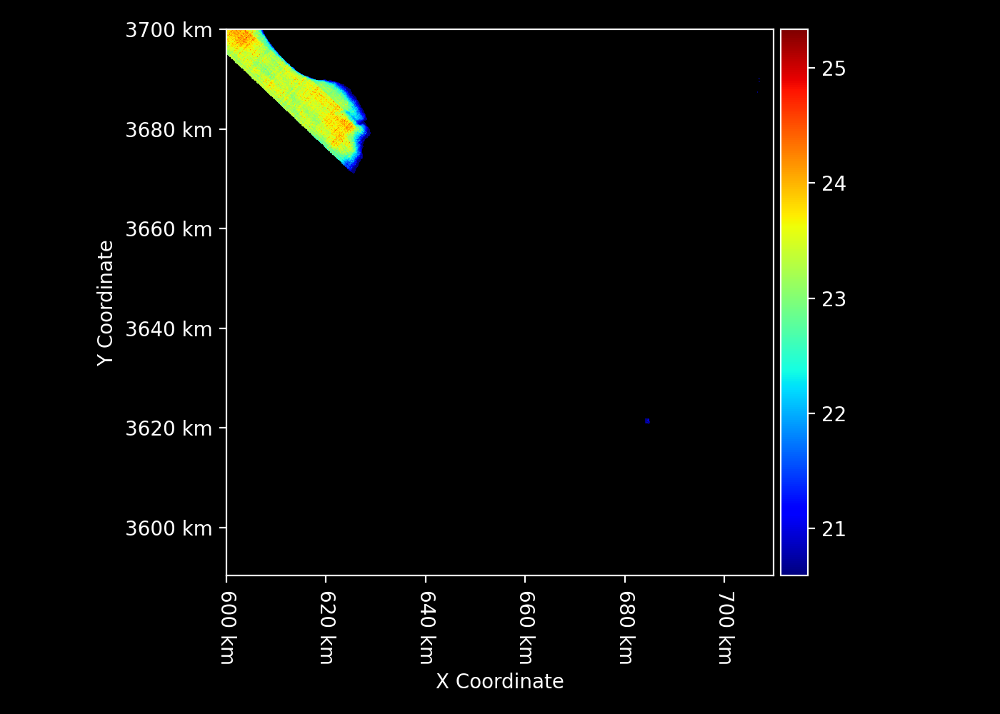

In [5]:
L2T_LSTE_granule.ST_C

Retrieve L2T STARS granule from CMR API as prior

In [6]:
L2T_STARS_granule = download_ECOSTRESS_granule(
    product="L2T_STARS", 
    tile="11SPS", 
    aquisition_date="2024-10-22",
    parent_directory=working_directory
)

L2T_STARS_granule

--2024-11-26 15:40:35--  https://data.lpdaac.earthdatacloud.nasa.gov/lp-prod-protected/ECO_L2T_STARS.002/ECOv002_L2T_STARS_11SPS_20241022_0713_01/ECOv002_L2T_STARS_11SPS_20241022_0713_01_NDVI.tif
Resolving data.lpdaac.earthdatacloud.nasa.gov (data.lpdaac.earthdatacloud.nasa.gov)... 18.154.144.127, 18.154.144.29, 18.154.144.87, ...
Connecting to data.lpdaac.earthdatacloud.nasa.gov (data.lpdaac.earthdatacloud.nasa.gov)|18.154.144.127|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://urs.earthdata.nasa.gov/oauth/authorize?client_id=FtSFfbOeuxDcdf4px-elGw&response_type=code&redirect_uri=https://data.lpdaac.earthdatacloud.nasa.gov/login&state=%2Flp-prod-protected%2FECO_L2T_STARS.002%2FECOv002_L2T_STARS_11SPS_20241022_0713_01%2FECOv002_L2T_STARS_11SPS_20241022_0713_01_NDVI.tif&app_type=401 [following]
--2024-11-26 15:40:35--  https://urs.earthdata.nasa.gov/oauth/authorize?client_id=FtSFfbOeuxDcdf4px-elGw&response_type=code&redirect_uri=https://data.lpdaac

L2TSTARS("/Users/halverso/data/ECOSTRESS_demo/ECOv002_L2T_STARS_11SPS_20241022_0713_01")

Load and display preview of vegetation index

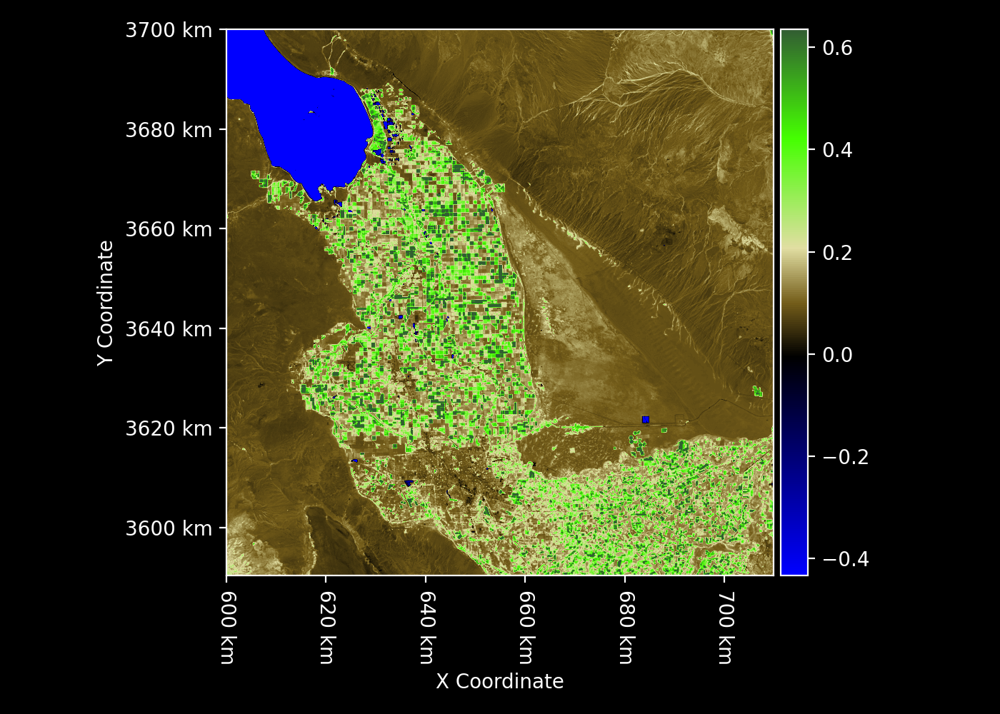

In [7]:
L2T_STARS_granule.NDVI

Generate XML run-config file for L2T STARS PGE run

In [8]:
runconfig_filename = generate_L2T_STARS_runconfig(
    L2T_LSTE_filename=L2T_LSTE_granule.product_filename,
    prior_L2T_STARS_filename=L2T_STARS_granule.product_filename,
    working_directory=working_directory
)

runconfig_filename

'/Users/halverso/data/ECOSTRESS_demo/runconfig/ECOv002_L2T_STARS_11SPS_20241029_0700_01.xml'

In [9]:
with open(runconfig_filename, "r") as f:
    print(f.read())

<?xml version="1.0" encoding="UTF-8"?>
<input xmlns:xsi="http://www.w3.org/2001/XMLSchema-instance"
       xmlns:xalan="http://xml.apache.org/xslt"
       xmlns:cas="http://oodt.jpl.nasa.gov/1.0/cas"
       xsi:noNamespaceSchemaLocation="">
    <group name="LogMetadata">
        <vector name="CommandLineParameters">
            <element>L2T_STARS</element>
            <element>/Users/halverso/data/ECOSTRESS_demo/runconfig/ECOv002_L2T_STARS_11SPS_20241029_0700_01.xml</element>
            <element>/Users/halverso/data/ECOSTRESS_demo/log/ECOv002_L2T_STARS_11SPS_20241029_0700_01.log</element>
        </vector>
    </group>
    <group name="JobIdentification">
        <scalar name="ProductionLocation">ECOSTRESS Science Computing Facility</scalar>
        <scalar name="TaskId">urn:ecostress:L2GL2TLSTETask</scalar>
        <scalar name="ProcessingNode">MT-315735</scalar>
        <scalar name="ProductionDateTime">20241029</scalar>
        <scalar name="JobId">20241029</scalar>
        <scalar

In [ ]:
exit_code = L2T_STARS(runconfig_filename=runconfig_filename, use_VNP43NRT=False)
exit_code

[2024-11-26 15:41:11 INFO] L2T_STARS PGE (1.0.1)
[2024-11-26 15:41:11 INFO] L2T_STARS run-config: /Users/halverso/data/ECOSTRESS_demo/runconfig/ECOv002_L2T_STARS_11SPS_20241029_0700_01.xml
[2024-11-26 15:41:11 INFO] granule ID: ECOv002_L2T_STARS_11SPS_20241029_0700_01
[2024-11-26 15:41:11 INFO] granule directory: /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_output/ECOv002_L2T_STARS_11SPS_20241029_0700_01
[2024-11-26 15:41:11 INFO] zip filename: /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_output/ECOv002_L2T_STARS_11SPS_20241029_0700_01.zip
[2024-11-26 15:41:11 INFO] browse filename: /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_output/ECOv002_L2T_STARS_11SPS_20241029_0700_01.png
[2024-11-26 15:41:11 INFO] working_directory: /Users/halverso/data/ECOSTRESS_demo
[2024-11-26 15:41:11 INFO] log: /Users/halverso/data/ECOSTRESS_demo/log/ECOv002_L2T_STARS_11SPS_20241029_0700_01.log
[2024-11-26 15:41:11 INFO] source directory: /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES
[2024-11-26 

--2024-11-26 15:41:20--  https://e4ftl01.cr.usgs.gov/VIIRS/VNP43IA4.001/2024.10.22/VNP43IA4.A2024296.h08v05.001.2024305160627.h5.xml
Resolving e4ftl01.cr.usgs.gov (e4ftl01.cr.usgs.gov)... 2001:49c8:4000:127d::133:130, 152.61.133.130
Connecting to e4ftl01.cr.usgs.gov (e4ftl01.cr.usgs.gov)|2001:49c8:4000:127d::133:130|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://urs.earthdata.nasa.gov/oauth/authorize?scope=uid&app_type=401&client_id=ijpRZvb9qeKCK5ctsn75Tg&response_type=code&redirect_uri=https%3A%2F%2Fe4ftl01.cr.usgs.gov%2Foauth&state=aHR0cHM6Ly9lNGZ0bDAxLmNyLnVzZ3MuZ292L1ZJSVJTL1ZOUDQzSUE0LjAwMS8yMDI0LjEwLjIyL1ZOUDQzSUE0LkEyMDI0Mjk2LmgwOHYwNS4wMDEuMjAyNDMwNTE2MDYyNy5oNS54bWw [following]
--2024-11-26 15:41:20--  https://urs.earthdata.nasa.gov/oauth/authorize?scope=uid&app_type=401&client_id=ijpRZvb9qeKCK5ctsn75Tg&response_type=code&redirect_uri=https%3A%2F%2Fe4ftl01.cr.usgs.gov%2Foauth&state=aHR0cHM6Ly9lNGZ0bDAxLmNyLnVzZ3MuZ292L1ZJSVJTL1ZOUDQzSUE0

[2024-11-26 15:41:22 INFO] wget -nc -c --user jpldatabot --password Ec0stress -O /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.22/VNP43IA4.A2024296.h08v05.001.2024305160627.h5.xml https://e4ftl01.cr.usgs.gov/VIIRS/VNP43IA4.001/2024.10.22/VNP43IA4.A2024296.h08v05.001.2024305160627.h5.xml
[2024-11-26 15:41:22 INFO] wget -nc -c --user jpldatabot --password Ec0stress -O /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.22/VNP43IA4.A2024296.h08v05.001.2024305160627.h5.xml https://e4ftl01.cr.usgs.gov/VIIRS/VNP43IA4.001/2024.10.22/VNP43IA4.A2024296.h08v05.001.2024305160627.h5.xml
[2024-11-26 15:41:22 INFO] wget -nc -c --user jpldatabot --password Ec0stress -O /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.22/VNP43IA4.A2024296.h08v05.001.2024305160627.h5.xml https://e4ftl01.cr.usgs.gov/VIIRS/VNP43IA4.001/2024.10.22/VNP43IA4.A2024296.h08v05.001.2024305160627.h5.xml


HTTP request sent, awaiting response... 200 OK
Length: 3810 (3.7K) [application/xml]
Saving to: ‘/Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.22/VNP43IA4.A2024296.h08v05.001.2024305160627.h5.xml’

     0K ...                                                   100% 3.55G=0s

2024-11-26 15:41:22 (3.55 GB/s) - ‘/Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.22/VNP43IA4.A2024296.h08v05.001.2024305160627.h5.xml’ saved [3810/3810]

File ‘/Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.22/VNP43IA4.A2024296.h08v05.001.2024305160627.h5.xml’ already there; not retrieving.
File ‘/Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.22/VNP43IA4.A2024296.h08v05.001.2024305160627.h5.xml’ already there; not retrieving.


[2024-11-26 15:41:22 INFO] wget -nc -c --user jpldatabot --password Ec0stress -O /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.22/VNP43IA4.A2024296.h08v05.001.2024305160627.h5.xml https://e4ftl01.cr.usgs.gov/VIIRS/VNP43IA4.001/2024.10.22/VNP43IA4.A2024296.h08v05.001.2024305160627.h5.xml
[2024-11-26 15:41:22 INFO] wget -nc -c --user jpldatabot --password Ec0stress -O /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.22/VNP43IA4.A2024296.h08v05.001.2024305160627.h5.xml https://e4ftl01.cr.usgs.gov/VIIRS/VNP43IA4.001/2024.10.22/VNP43IA4.A2024296.h08v05.001.2024305160627.h5.xml
[2024-11-26 15:41:22 INFO] metadata retrieved MD5 checksum: 1cce55e7930854ca1f698897af982249 size: 22910689 URL: https://e4ftl01.cr.usgs.gov/VIIRS/VNP43IA4.001/2024.10.22/VNP43IA4.A2024296.h08v05.001.2024305160627.h5.xml
[2024-11-26 15:41:22 INFO] downloading https://e4ftl01.cr.usgs.gov/VIIRS/VNP43IA4.001/2024.10.22/VNP43IA4.A2024296.h08v05.0

File ‘/Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.22/VNP43IA4.A2024296.h08v05.001.2024305160627.h5.xml’ already there; not retrieving.
File ‘/Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.22/VNP43IA4.A2024296.h08v05.001.2024305160627.h5.xml’ already there; not retrieving.
File ‘/Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.22/VNP43IA4.A2024296.h08v05.001.2024305160627.h5.xml’ already there; not retrieving.
--2024-11-26 15:41:22--  https://e4ftl01.cr.usgs.gov/VIIRS/VNP43IA4.001/2024.10.22/VNP43IA4.A2024296.h08v05.001.2024305160627.h5
Resolving e4ftl01.cr.usgs.gov (e4ftl01.cr.usgs.gov)... 2001:49c8:4000:127d::133:130, 152.61.133.130
Connecting to e4ftl01.cr.usgs.gov (e4ftl01.cr.usgs.gov)|2001:49c8:4000:127d::133:130|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://urs.earthdata.nasa.gov/oauth/authorize?scope=uid&app_type=401&client

[2024-11-26 15:41:30 INFO] successful download with filesize 22910689 checksum 1cce55e7930854ca1f698897af982249: /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.22/VNP43IA4.A2024296.h08v05.001.2024305160627.h5


... .......... 95% 13.1M 0s
 21450K .......... .......... .......... .......... .......... 96% 10.1M 0s
 21500K .......... .......... .......... .......... .......... 96% 2.87M 0s
 21550K .......... .......... .......... .......... .......... 96% 4.29M 0s
 21600K .......... .......... .......... .......... .......... 96% 2.05M 0s
 21650K .......... .......... .......... .......... .......... 96% 10.7M 0s
 21700K .......... .......... .......... .......... .......... 97% 16.5M 0s
 21750K .......... .......... .......... .......... .......... 97% 8.84M 0s
 21800K .......... .......... .......... .......... .......... 97% 6.28M 0s
 21850K .......... .......... .......... .......... .......... 97% 6.91M 0s
 21900K .......... .......... .......... .......... .......... 98% 40.6M 0s
 21950K .......... .......... .......... .......... .......... 98% 3.52M 0s
 22000K .......... .......... .......... .......... .......... 98% 15.9M 0s
 22050K .......... .......... .......... .......... ........

[2024-11-26 15:41:30 INFO] opening VIIRS file: /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.22/VNP43IA4.A2024296.h08v05.001.2024305160627.h5
[2024-11-26 15:41:30 INFO] loading HDFEOS/GRIDS/VIIRS_Grid_BRDF/Data Fields/Nadir_Reflectance_I2 at 463.31 m resolution
[2024-11-26 15:41:30 INFO] opening file: /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.22/VNP43IA4.A2024296.h08v05.001.2024305160627.h5
[2024-11-26 15:41:30 INFO] loading HDFEOS/GRIDS/VIIRS_Grid_BRDF/Data Fields/BRDF_Albedo_Band_Mandatory_Quality_I2 at 463.31 m resolution
[2024-11-26 15:41:30 INFO] opening VIIRS file: /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.22/VNP43IA4.A2024296.h08v05.001.2024305160627.h5
[2024-11-26 15:41:30 INFO] loading HDFEOS/GRIDS/VIIRS_Grid_BRDF/Data Fields/Nadir_Reflectance_I1 at 463.31 m resolution
[2024-11-26 15:41:30 INFO] opening file: /Users/halverso/data/ECOSTRESS_demo/L2T_ST

--2024-11-26 15:41:33--  https://e4ftl01.cr.usgs.gov/VIIRS/VNP43MA3.001/2024.10.22/VNP43MA3.A2024296.h08v05.001.2024305160627.h5.xml
Resolving e4ftl01.cr.usgs.gov (e4ftl01.cr.usgs.gov)... 2001:49c8:4000:127d::133:130, 152.61.133.130
Connecting to e4ftl01.cr.usgs.gov (e4ftl01.cr.usgs.gov)|2001:49c8:4000:127d::133:130|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://urs.earthdata.nasa.gov/oauth/authorize?scope=uid&app_type=401&client_id=ijpRZvb9qeKCK5ctsn75Tg&response_type=code&redirect_uri=https%3A%2F%2Fe4ftl01.cr.usgs.gov%2Foauth&state=aHR0cHM6Ly9lNGZ0bDAxLmNyLnVzZ3MuZ292L1ZJSVJTL1ZOUDQzTUEzLjAwMS8yMDI0LjEwLjIyL1ZOUDQzTUEzLkEyMDI0Mjk2LmgwOHYwNS4wMDEuMjAyNDMwNTE2MDYyNy5oNS54bWw [following]
--2024-11-26 15:41:33--  https://urs.earthdata.nasa.gov/oauth/authorize?scope=uid&app_type=401&client_id=ijpRZvb9qeKCK5ctsn75Tg&response_type=code&redirect_uri=https%3A%2F%2Fe4ftl01.cr.usgs.gov%2Foauth&state=aHR0cHM6Ly9lNGZ0bDAxLmNyLnVzZ3MuZ292L1ZJSVJTL1ZOUDQzTUEz

[2024-11-26 15:41:35 INFO] wget -nc -c --user jpldatabot --password Ec0stress -O /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43MA3/2024.10.22/VNP43MA3.A2024296.h08v05.001.2024305160627.h5.xml https://e4ftl01.cr.usgs.gov/VIIRS/VNP43MA3.001/2024.10.22/VNP43MA3.A2024296.h08v05.001.2024305160627.h5.xml
[2024-11-26 15:41:35 INFO] wget -nc -c --user jpldatabot --password Ec0stress -O /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43MA3/2024.10.22/VNP43MA3.A2024296.h08v05.001.2024305160627.h5.xml https://e4ftl01.cr.usgs.gov/VIIRS/VNP43MA3.001/2024.10.22/VNP43MA3.A2024296.h08v05.001.2024305160627.h5.xml
[2024-11-26 15:41:35 INFO] wget -nc -c --user jpldatabot --password Ec0stress -O /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43MA3/2024.10.22/VNP43MA3.A2024296.h08v05.001.2024305160627.h5.xml https://e4ftl01.cr.usgs.gov/VIIRS/VNP43MA3.001/2024.10.22/VNP43MA3.A2024296.h08v05.001.2024305160627.h5.xml
[2024-11-26 15:4

HTTP request sent, awaiting response... 200 OK
Length: 3810 (3.7K) [application/xml]
Saving to: ‘/Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43MA3/2024.10.22/VNP43MA3.A2024296.h08v05.001.2024305160627.h5.xml’

     0K ...                                                   100% 3.55G=0s

2024-11-26 15:41:35 (3.55 GB/s) - ‘/Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43MA3/2024.10.22/VNP43MA3.A2024296.h08v05.001.2024305160627.h5.xml’ saved [3810/3810]

File ‘/Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43MA3/2024.10.22/VNP43MA3.A2024296.h08v05.001.2024305160627.h5.xml’ already there; not retrieving.
File ‘/Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43MA3/2024.10.22/VNP43MA3.A2024296.h08v05.001.2024305160627.h5.xml’ already there; not retrieving.
File ‘/Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43MA3/2024.10.22/VNP43MA3.A2024296.h08v05.001.2024305160627

[2024-11-26 15:41:46 INFO] successful download with filesize 31412744 checksum f7e9e3bfbaa7f61722ebf89d39d37611: /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43MA3/2024.10.22/VNP43MA3.A2024296.h08v05.001.2024305160627.h5
[2024-11-26 15:41:46 INFO] GEOS-5 FP working directory: .
[2024-11-26 15:41:46 INFO] GEOS-5 FP download directory: ./GEOS5FP_download_directory
[2024-11-26 15:41:46 INFO] GEOS-5 FP products directory: ./GEOS5FP_products


....... .......... .......... .......... .......... 98%  847K 0s
 30250K .......... .......... .......... .......... .......... 98% 6.21M 0s
 30300K .......... .......... .......... .......... .......... 98%  303M 0s
 30350K .......... .......... .......... .......... .......... 99% 3.69M 0s
 30400K .......... .......... .......... .......... .......... 99% 11.0M 0s
 30450K .......... .......... .......... .......... .......... 99% 13.8M 0s
 30500K .......... .......... .......... .......... .......... 99% 2.90M 0s
 30550K .......... .......... .......... .......... .......... 99% 2.69M 0s
 30600K .......... .......... .......... .......... .......... 99% 9.28M 0s
 30650K .......... .......... ......                          100% 31.8M=7.7s

2024-11-26 15:41:46 (3.87 MB/s) - ‘/Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43MA3/2024.10.22/VNP43MA3.A2024296.h08v05.001.2024305160627.h5.download’ saved [31412744/31412744]



[2024-11-26 15:41:46 INFO] retrieving AOT from GEOS-5 FP tavg3_2d_aer_Nx TOTEXTTAU for 2024-10-22 10:30 UTC
[2024-11-26 15:41:46 INFO] searching GEOS-5 FP tavg3_2d_aer_Nx at 2024-10-22 10:30:00 UTC
[2024-11-26 15:41:46 INFO] downloading GEOS-5 FP: https://portal.nccs.nasa.gov/datashare/gmao/geos-fp/das/Y2024/M10/D22/GEOS.fp.asm.tavg3_2d_aer_Nx.20241022_0730.V01.nc4 -> ./GEOS5FP_download_directory/2024.10.22/GEOS.fp.asm.tavg3_2d_aer_Nx.20241022_0730.V01.nc4


--2024-11-26 15:41:47--  https://portal.nccs.nasa.gov/datashare/gmao/geos-fp/das/Y2024/M10/D22/GEOS.fp.asm.tavg3_2d_aer_Nx.20241022_0730.V01.nc4
Resolving portal.nccs.nasa.gov (portal.nccs.nasa.gov)... 2001:4d0:2418:2800::a99a:9791, 169.154.151.145
Connecting to portal.nccs.nasa.gov (portal.nccs.nasa.gov)|2001:4d0:2418:2800::a99a:9791|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 121034494 (115M) [application/octet-stream]
Saving to: ‘./GEOS5FP_download_directory/2024.10.22/GEOS.fp.asm.tavg3_2d_aer_Nx.20241022_0730.V01.nc4.20241126234146.download’

     0K .......... .......... .......... .......... ..........  0%  265K 7m26s
    50K .......... .......... .......... .......... ..........  0%  491K 5m43s
   100K .......... .......... .......... .......... ..........  0% 9.33M 3m53s
   150K .......... .......... .......... .......... ..........  0% 11.5M 2m57s
   200K .......... .......... .......... .......... ..........  0%  516K 3m7s
   250K .......... ....

[2024-11-26 15:42:33 INFO] GEOS-5 FP download completed: ./GEOS5FP_download_directory/2024.10.22/GEOS.fp.asm.tavg3_2d_aer_Nx.20241022_0730.V01.nc4 (121.03 mb) (46.729081958999814 seconds)
[2024-11-26 15:42:33 INFO] GEOS-5 FP working directory: .
[2024-11-26 15:42:33 INFO] GEOS-5 FP products directory: ./GEOS5FP_products


......... .......... 99% 8.76M 0s
118050K .......... .......... .......... .......... .......... 99% 14.3M 0s
118100K .......... .......... .......... .......... .......... 99% 12.0M 0s
118150K .......... .......... .......... .......... .......   100% 6.84M=46s

2024-11-26 15:42:33 (2.50 MB/s) - ‘./GEOS5FP_download_directory/2024.10.22/GEOS.fp.asm.tavg3_2d_aer_Nx.20241022_0730.V01.nc4.20241126234146.download’ saved [121034494/121034494]

/opt/homebrew/Caskroom/miniforge/base/envs/ECOv003-L2T-STARS/lib/python3.11/site-packages/rasterio/__init__.py:355: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dataset = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


[2024-11-26 15:42:34 INFO] downloading GEOS-5 FP: https://portal.nccs.nasa.gov/datashare/gmao/geos-fp/das/Y2024/M10/D22/GEOS.fp.asm.tavg3_2d_aer_Nx.20241022_1330.V01.nc4 -> ./GEOS5FP_download_directory/2024.10.22/GEOS.fp.asm.tavg3_2d_aer_Nx.20241022_1330.V01.nc4


--2024-11-26 15:42:34--  https://portal.nccs.nasa.gov/datashare/gmao/geos-fp/das/Y2024/M10/D22/GEOS.fp.asm.tavg3_2d_aer_Nx.20241022_1330.V01.nc4
Resolving portal.nccs.nasa.gov (portal.nccs.nasa.gov)... 2001:4d0:2418:2800::a99a:9791, 169.154.151.145
Connecting to portal.nccs.nasa.gov (portal.nccs.nasa.gov)|2001:4d0:2418:2800::a99a:9791|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 121032775 (115M) [application/octet-stream]
Saving to: ‘./GEOS5FP_download_directory/2024.10.22/GEOS.fp.asm.tavg3_2d_aer_Nx.20241022_1330.V01.nc4.20241126234234.download’

     0K .......... .......... .......... .......... ..........  0%  224K 8m48s
    50K .......... .......... .......... .......... ..........  0%  508K 6m20s
   100K .......... .......... .......... .......... ..........  0% 6.30M 4m19s
   150K .......... .......... .......... .......... ..........  0% 5.47M 3m20s
   200K .......... .......... .......... .......... ..........  0%  527K 3m24s
   250K .......... ...

[2024-11-26 15:43:54 INFO] GEOS-5 FP download completed: ./GEOS5FP_download_directory/2024.10.22/GEOS.fp.asm.tavg3_2d_aer_Nx.20241022_1330.V01.nc4 (121.03 mb) (80.14932945799956 seconds)
[2024-11-26 15:43:54 INFO] GEOS-5 FP working directory: .
[2024-11-26 15:43:54 INFO] GEOS-5 FP products directory: ./GEOS5FP_products
[2024-11-26 15:43:54 INFO] interpolating GEOS-5 FP tavg3_2d_aer_Nx TOTEXTTAU from 2024-10-22 07:30 UTC and 2024-10-22 13:30 UTC to 2024-10-22 10:30 UTC


... .......... 99%  541K 0s
118100K .......... .......... .......... .......... .......... 99% 9.07M 0s
118150K .......... .......... .......... .......... ......    100% 6.42M=80s

2024-11-26 15:43:54 (1.45 MB/s) - ‘./GEOS5FP_download_directory/2024.10.22/GEOS.fp.asm.tavg3_2d_aer_Nx.20241022_1330.V01.nc4.20241126234234.download’ saved [121032775/121032775]



[2024-11-26 15:43:54 INFO] GEOS-5 FP interpolation complete (0.27 seconds)
[2024-11-26 15:43:54 INFO] opening VIIRS file: /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43MA3/2024.10.22/VNP43MA3.A2024296.h08v05.001.2024305160627.h5
[2024-11-26 15:43:54 INFO] loading HDFEOS/GRIDS/VIIRS_Grid_BRDF/Data Fields/Albedo_WSA_M1 at 926.63 m resolution
[2024-11-26 15:43:54 INFO] opening file: /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43MA3/2024.10.22/VNP43MA3.A2024296.h08v05.001.2024305160627.h5
[2024-11-26 15:43:54 INFO] loading HDFEOS/GRIDS/VIIRS_Grid_BRDF/Data Fields/BRDF_Albedo_Band_Mandatory_Quality_M1 at 926.63 m resolution
[2024-11-26 15:43:54 INFO] writing VNP43MA3 QA M1: /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_products/VNP43MA3_QA_M1/2024.10.22/VNP43MA3.A2024296.h08v05.001.2024305160627_VNP43MA3_QA_M1.tif
[2024-11-26 15:43:54 INFO] writing VNP43MA3 WSA M1: /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VII

--2024-11-26 15:44:04--  https://e4ftl01.cr.usgs.gov/VIIRS/VNP43IA4.001/2024.10.23/VNP43IA4.A2024297.h08v05.001.2024305195810.h5.xml
Resolving e4ftl01.cr.usgs.gov (e4ftl01.cr.usgs.gov)... 2001:49c8:4000:127d::133:130, 152.61.133.130
Connecting to e4ftl01.cr.usgs.gov (e4ftl01.cr.usgs.gov)|2001:49c8:4000:127d::133:130|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://urs.earthdata.nasa.gov/oauth/authorize?scope=uid&app_type=401&client_id=ijpRZvb9qeKCK5ctsn75Tg&response_type=code&redirect_uri=https%3A%2F%2Fe4ftl01.cr.usgs.gov%2Foauth&state=aHR0cHM6Ly9lNGZ0bDAxLmNyLnVzZ3MuZ292L1ZJSVJTL1ZOUDQzSUE0LjAwMS8yMDI0LjEwLjIzL1ZOUDQzSUE0LkEyMDI0Mjk3LmgwOHYwNS4wMDEuMjAyNDMwNTE5NTgxMC5oNS54bWw [following]
--2024-11-26 15:44:05--  https://urs.earthdata.nasa.gov/oauth/authorize?scope=uid&app_type=401&client_id=ijpRZvb9qeKCK5ctsn75Tg&response_type=code&redirect_uri=https%3A%2F%2Fe4ftl01.cr.usgs.gov%2Foauth&state=aHR0cHM6Ly9lNGZ0bDAxLmNyLnVzZ3MuZ292L1ZJSVJTL1ZOUDQzSUE0

[2024-11-26 15:44:07 INFO] wget -nc -c --user jpldatabot --password Ec0stress -O /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.23/VNP43IA4.A2024297.h08v05.001.2024305195810.h5.xml https://e4ftl01.cr.usgs.gov/VIIRS/VNP43IA4.001/2024.10.23/VNP43IA4.A2024297.h08v05.001.2024305195810.h5.xml
[2024-11-26 15:44:07 INFO] wget -nc -c --user jpldatabot --password Ec0stress -O /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.23/VNP43IA4.A2024297.h08v05.001.2024305195810.h5.xml https://e4ftl01.cr.usgs.gov/VIIRS/VNP43IA4.001/2024.10.23/VNP43IA4.A2024297.h08v05.001.2024305195810.h5.xml
[2024-11-26 15:44:07 INFO] wget -nc -c --user jpldatabot --password Ec0stress -O /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.23/VNP43IA4.A2024297.h08v05.001.2024305195810.h5.xml https://e4ftl01.cr.usgs.gov/VIIRS/VNP43IA4.001/2024.10.23/VNP43IA4.A2024297.h08v05.001.2024305195810.h5.xml
[2024-11-26 15:4

HTTP request sent, awaiting response... 200 OK
Length: 3809 (3.7K) [application/xml]
Saving to: ‘/Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.23/VNP43IA4.A2024297.h08v05.001.2024305195810.h5.xml’

     0K ...                                                   100% 3.55G=0s

2024-11-26 15:44:07 (3.55 GB/s) - ‘/Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.23/VNP43IA4.A2024297.h08v05.001.2024305195810.h5.xml’ saved [3809/3809]

File ‘/Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.23/VNP43IA4.A2024297.h08v05.001.2024305195810.h5.xml’ already there; not retrieving.
File ‘/Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.23/VNP43IA4.A2024297.h08v05.001.2024305195810.h5.xml’ already there; not retrieving.
File ‘/Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.23/VNP43IA4.A2024297.h08v05.001.2024305195810

[2024-11-26 15:44:07 INFO] wget -nc -c --user jpldatabot --password Ec0stress -O /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.23/VNP43IA4.A2024297.h08v05.001.2024305195810.h5.xml https://e4ftl01.cr.usgs.gov/VIIRS/VNP43IA4.001/2024.10.23/VNP43IA4.A2024297.h08v05.001.2024305195810.h5.xml
[2024-11-26 15:44:07 INFO] metadata retrieved MD5 checksum: 8d33fc28f90015a8cb89026e8473e6b1 size: 22910336 URL: https://e4ftl01.cr.usgs.gov/VIIRS/VNP43IA4.001/2024.10.23/VNP43IA4.A2024297.h08v05.001.2024305195810.h5.xml
[2024-11-26 15:44:07 INFO] downloading https://e4ftl01.cr.usgs.gov/VIIRS/VNP43IA4.001/2024.10.23/VNP43IA4.A2024297.h08v05.001.2024305195810.h5 -> /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.23/VNP43IA4.A2024297.h08v05.001.2024305195810.h5
[2024-11-26 15:44:07 INFO] wget -nc -c --user jpldatabot --password Ec0stress -O /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.23/

File ‘/Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.23/VNP43IA4.A2024297.h08v05.001.2024305195810.h5.xml’ already there; not retrieving.
File ‘/Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.23/VNP43IA4.A2024297.h08v05.001.2024305195810.h5.xml’ already there; not retrieving.
--2024-11-26 15:44:07--  https://e4ftl01.cr.usgs.gov/VIIRS/VNP43IA4.001/2024.10.23/VNP43IA4.A2024297.h08v05.001.2024305195810.h5
Resolving e4ftl01.cr.usgs.gov (e4ftl01.cr.usgs.gov)... 2001:49c8:4000:127d::133:130, 152.61.133.130
Connecting to e4ftl01.cr.usgs.gov (e4ftl01.cr.usgs.gov)|2001:49c8:4000:127d::133:130|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://urs.earthdata.nasa.gov/oauth/authorize?scope=uid&app_type=401&client_id=ijpRZvb9qeKCK5ctsn75Tg&response_type=code&redirect_uri=https%3A%2F%2Fe4ftl01.cr.usgs.gov%2Foauth&state=aHR0cHM6Ly9lNGZ0bDAxLmNyLnVzZ3MuZ292L1ZJSVJTL1ZOUDQzSUE0LjAwMS8yMDI0Lj

[2024-11-26 15:44:15 INFO] successful download with filesize 22910336 checksum 8d33fc28f90015a8cb89026e8473e6b1: /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.23/VNP43IA4.A2024297.h08v05.001.2024305195810.h5
[2024-11-26 15:44:15 INFO] opening VIIRS file: /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.23/VNP43IA4.A2024297.h08v05.001.2024305195810.h5
[2024-11-26 15:44:15 INFO] loading HDFEOS/GRIDS/VIIRS_Grid_BRDF/Data Fields/Nadir_Reflectance_I2 at 463.31 m resolution
[2024-11-26 15:44:15 INFO] opening file: /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.23/VNP43IA4.A2024297.h08v05.001.2024305195810.h5
[2024-11-26 15:44:15 INFO] loading HDFEOS/GRIDS/VIIRS_Grid_BRDF/Data Fields/BRDF_Albedo_Band_Mandatory_Quality_I2 at 463.31 m resolution
[2024-11-26 15:44:15 INFO] opening VIIRS file: /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.23/V

QUEUEING TASKS | :   0%|          | 0/18 [00:00<?, ?it/s]

PROCESSING TASKS | :   0%|          | 0/18 [00:00<?, ?it/s]

COLLECTING RESULTS | :   0%|          | 0/18 [00:00<?, ?it/s]

[2024-11-26 15:44:26 INFO] searching for Landsat tile 11SPS on 2024-10-23
[2024-11-26 15:44:27 INFO] saving fine image for STARS NDVI at 11SPS on 2024-10-23: /Users/halverso/data/ECOSTRESS_demo/input_staging/NDVI_fine_11SPS/STARS_NDVI_2024-10-23_11SPS_70m.tif
[2024-11-26 15:44:27 INFO] preparing coarse image for STARS albedo at 11SPS on 2024-10-23
[2024-11-26 15:44:27 INFO] scanning LP-DAAC: https://e4ftl01.cr.usgs.gov/VIIRS/VNP43MA3.001/2024.10.23
[2024-11-26 15:44:29 INFO] checking metadata: https://e4ftl01.cr.usgs.gov/VIIRS/VNP43MA3.001/2024.10.23/VNP43MA3.A2024297.h08v05.001.2024305195810.h5.xml
[2024-11-26 15:44:29 INFO] wget -nc -c --user jpldatabot --password Ec0stress -O /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43MA3/2024.10.23/VNP43MA3.A2024297.h08v05.001.2024305195810.h5.xml https://e4ftl01.cr.usgs.gov/VIIRS/VNP43MA3.001/2024.10.23/VNP43MA3.A2024297.h08v05.001.2024305195810.h5.xml


--2024-11-26 15:44:29--  https://e4ftl01.cr.usgs.gov/VIIRS/VNP43MA3.001/2024.10.23/VNP43MA3.A2024297.h08v05.001.2024305195810.h5.xml
Resolving e4ftl01.cr.usgs.gov (e4ftl01.cr.usgs.gov)... 2001:49c8:4000:127d::133:130, 152.61.133.130
Connecting to e4ftl01.cr.usgs.gov (e4ftl01.cr.usgs.gov)|2001:49c8:4000:127d::133:130|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://urs.earthdata.nasa.gov/oauth/authorize?scope=uid&app_type=401&client_id=ijpRZvb9qeKCK5ctsn75Tg&response_type=code&redirect_uri=https%3A%2F%2Fe4ftl01.cr.usgs.gov%2Foauth&state=aHR0cHM6Ly9lNGZ0bDAxLmNyLnVzZ3MuZ292L1ZJSVJTL1ZOUDQzTUEzLjAwMS8yMDI0LjEwLjIzL1ZOUDQzTUEzLkEyMDI0Mjk3LmgwOHYwNS4wMDEuMjAyNDMwNTE5NTgxMC5oNS54bWw [following]
--2024-11-26 15:44:29--  https://urs.earthdata.nasa.gov/oauth/authorize?scope=uid&app_type=401&client_id=ijpRZvb9qeKCK5ctsn75Tg&response_type=code&redirect_uri=https%3A%2F%2Fe4ftl01.cr.usgs.gov%2Foauth&state=aHR0cHM6Ly9lNGZ0bDAxLmNyLnVzZ3MuZ292L1ZJSVJTL1ZOUDQzTUEz

[2024-11-26 15:44:31 INFO] wget -nc -c --user jpldatabot --password Ec0stress -O /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43MA3/2024.10.23/VNP43MA3.A2024297.h08v05.001.2024305195810.h5.xml https://e4ftl01.cr.usgs.gov/VIIRS/VNP43MA3.001/2024.10.23/VNP43MA3.A2024297.h08v05.001.2024305195810.h5.xml
[2024-11-26 15:44:31 INFO] wget -nc -c --user jpldatabot --password Ec0stress -O /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43MA3/2024.10.23/VNP43MA3.A2024297.h08v05.001.2024305195810.h5.xml https://e4ftl01.cr.usgs.gov/VIIRS/VNP43MA3.001/2024.10.23/VNP43MA3.A2024297.h08v05.001.2024305195810.h5.xml
[2024-11-26 15:44:31 INFO] wget -nc -c --user jpldatabot --password Ec0stress -O /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43MA3/2024.10.23/VNP43MA3.A2024297.h08v05.001.2024305195810.h5.xml https://e4ftl01.cr.usgs.gov/VIIRS/VNP43MA3.001/2024.10.23/VNP43MA3.A2024297.h08v05.001.2024305195810.h5.xml
[2024-11-26 15:4

HTTP request sent, awaiting response... 200 OK
Length: 3811 (3.7K) [application/xml]
Saving to: ‘/Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43MA3/2024.10.23/VNP43MA3.A2024297.h08v05.001.2024305195810.h5.xml’

     0K ...                                                   100% 1.77G=0s

2024-11-26 15:44:31 (1.77 GB/s) - ‘/Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43MA3/2024.10.23/VNP43MA3.A2024297.h08v05.001.2024305195810.h5.xml’ saved [3811/3811]

File ‘/Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43MA3/2024.10.23/VNP43MA3.A2024297.h08v05.001.2024305195810.h5.xml’ already there; not retrieving.
File ‘/Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43MA3/2024.10.23/VNP43MA3.A2024297.h08v05.001.2024305195810.h5.xml’ already there; not retrieving.
File ‘/Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43MA3/2024.10.23/VNP43MA3.A2024297.h08v05.001.2024305195810

[2024-11-26 15:44:44 INFO] successful download with filesize 31406761 checksum 985ce95f70605c934366680d857cf905: /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43MA3/2024.10.23/VNP43MA3.A2024297.h08v05.001.2024305195810.h5
[2024-11-26 15:44:44 INFO] GEOS-5 FP working directory: .
[2024-11-26 15:44:44 INFO] GEOS-5 FP download directory: ./GEOS5FP_download_directory
[2024-11-26 15:44:44 INFO] GEOS-5 FP products directory: ./GEOS5FP_products
[2024-11-26 15:44:45 INFO] retrieving AOT from GEOS-5 FP tavg3_2d_aer_Nx TOTEXTTAU for 2024-10-23 10:30 UTC
[2024-11-26 15:44:45 INFO] searching GEOS-5 FP tavg3_2d_aer_Nx at 2024-10-23 10:30:00 UTC
[2024-11-26 15:44:45 INFO] downloading GEOS-5 FP: https://portal.nccs.nasa.gov/datashare/gmao/geos-fp/das/Y2024/M10/D23/GEOS.fp.asm.tavg3_2d_aer_Nx.20241023_0730.V01.nc4 -> ./GEOS5FP_download_directory/2024.10.23/GEOS.fp.asm.tavg3_2d_aer_Nx.20241023_0730.V01.nc4


--2024-11-26 15:44:45--  https://portal.nccs.nasa.gov/datashare/gmao/geos-fp/das/Y2024/M10/D23/GEOS.fp.asm.tavg3_2d_aer_Nx.20241023_0730.V01.nc4
Resolving portal.nccs.nasa.gov (portal.nccs.nasa.gov)... 169.154.151.145, 2001:4d0:2418:2800::a99a:9791
Connecting to portal.nccs.nasa.gov (portal.nccs.nasa.gov)|169.154.151.145|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 120994671 (115M) [application/octet-stream]
Saving to: ‘./GEOS5FP_download_directory/2024.10.23/GEOS.fp.asm.tavg3_2d_aer_Nx.20241023_0730.V01.nc4.20241126234445.download’

     0K .......... .......... .......... .......... ..........  0%  267K 7m22s
    50K .......... .......... .......... .......... ..........  0%  611K 5m17s
   100K .......... .......... .......... .......... ..........  0% 4.46M 3m40s
   150K .......... .......... .......... .......... ..........  0% 1.97M 3m0s
   200K .......... .......... .......... .......... ..........  0%  878K 2m50s
   250K .......... .......... .......

[2024-11-26 15:45:35 INFO] GEOS-5 FP download completed: ./GEOS5FP_download_directory/2024.10.23/GEOS.fp.asm.tavg3_2d_aer_Nx.20241023_0730.V01.nc4 (120.99 mb) (50.05167312500089 seconds)
[2024-11-26 15:45:35 INFO] GEOS-5 FP working directory: .
[2024-11-26 15:45:35 INFO] GEOS-5 FP products directory: ./GEOS5FP_products


..... .......... .......... 99% 1.51M 0s
118000K .......... .......... .......... .......... .......... 99% 2.13M 0s
118050K .......... .......... .......... .......... .......... 99% 7.96M 0s
118100K .......... .......... .......... .......... .......... 99% 7.44M 0s
118150K ........                                              100% 4.14M=50s

2024-11-26 15:45:35 (2.33 MB/s) - ‘./GEOS5FP_download_directory/2024.10.23/GEOS.fp.asm.tavg3_2d_aer_Nx.20241023_0730.V01.nc4.20241126234445.download’ saved [120994671/120994671]

/opt/homebrew/Caskroom/miniforge/base/envs/ECOv003-L2T-STARS/lib/python3.11/site-packages/rasterio/__init__.py:355: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dataset = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


[2024-11-26 15:45:36 INFO] downloading GEOS-5 FP: https://portal.nccs.nasa.gov/datashare/gmao/geos-fp/das/Y2024/M10/D23/GEOS.fp.asm.tavg3_2d_aer_Nx.20241023_1330.V01.nc4 -> ./GEOS5FP_download_directory/2024.10.23/GEOS.fp.asm.tavg3_2d_aer_Nx.20241023_1330.V01.nc4


--2024-11-26 15:45:36--  https://portal.nccs.nasa.gov/datashare/gmao/geos-fp/das/Y2024/M10/D23/GEOS.fp.asm.tavg3_2d_aer_Nx.20241023_1330.V01.nc4
Resolving portal.nccs.nasa.gov (portal.nccs.nasa.gov)... 169.154.151.145, 2001:4d0:2418:2800::a99a:9791
Connecting to portal.nccs.nasa.gov (portal.nccs.nasa.gov)|169.154.151.145|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 121006131 (115M) [application/octet-stream]
Saving to: ‘./GEOS5FP_download_directory/2024.10.23/GEOS.fp.asm.tavg3_2d_aer_Nx.20241023_1330.V01.nc4.20241126234536.download’

     0K .......... .......... .......... .......... ..........  0%  275K 7m9s
    50K .......... .......... .......... .......... ..........  0%  551K 5m22s
   100K .......... .......... .......... .......... ..........  0% 3.69M 3m45s
   150K .......... .......... .......... .......... ..........  0% 7.91M 2m52s
   200K .......... .......... .......... .......... ..........  0%  425K 3m13s
   250K .......... .......... .......

[2024-11-26 15:47:10 INFO] GEOS-5 FP download completed: ./GEOS5FP_download_directory/2024.10.23/GEOS.fp.asm.tavg3_2d_aer_Nx.20241023_1330.V01.nc4 (121.01 mb) (94.12625516600019 seconds)
[2024-11-26 15:47:10 INFO] GEOS-5 FP working directory: .
[2024-11-26 15:47:10 INFO] GEOS-5 FP products directory: ./GEOS5FP_products
[2024-11-26 15:47:10 INFO] interpolating GEOS-5 FP tavg3_2d_aer_Nx TOTEXTTAU from 2024-10-23 07:30 UTC and 2024-10-23 13:30 UTC to 2024-10-23 10:30 UTC


....... 99% 1.25M 0s
118150K .......... ..........                                 100% 52.8M=93s

2024-11-26 15:47:10 (1.24 MB/s) - ‘./GEOS5FP_download_directory/2024.10.23/GEOS.fp.asm.tavg3_2d_aer_Nx.20241023_1330.V01.nc4.20241126234536.download’ saved [121006131/121006131]



[2024-11-26 15:47:10 INFO] GEOS-5 FP interpolation complete (0.28 seconds)
[2024-11-26 15:47:10 INFO] opening VIIRS file: /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43MA3/2024.10.23/VNP43MA3.A2024297.h08v05.001.2024305195810.h5
[2024-11-26 15:47:10 INFO] loading HDFEOS/GRIDS/VIIRS_Grid_BRDF/Data Fields/Albedo_WSA_M1 at 926.63 m resolution
[2024-11-26 15:47:10 INFO] opening file: /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43MA3/2024.10.23/VNP43MA3.A2024297.h08v05.001.2024305195810.h5
[2024-11-26 15:47:10 INFO] loading HDFEOS/GRIDS/VIIRS_Grid_BRDF/Data Fields/BRDF_Albedo_Band_Mandatory_Quality_M1 at 926.63 m resolution
[2024-11-26 15:47:10 INFO] writing VNP43MA3 QA M1: /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_products/VNP43MA3_QA_M1/2024.10.23/VNP43MA3.A2024297.h08v05.001.2024305195810_VNP43MA3_QA_M1.tif
[2024-11-26 15:47:11 INFO] writing VNP43MA3 WSA M1: /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VII

QUEUEING TASKS | :   0%|          | 0/18 [00:00<?, ?it/s]

[2024-11-26 15:47:19 INFO] File HLS.S30.T11SPS.2024297T181329.v2.0.B01.tif already downloaded
[2024-11-26 15:47:19 INFO] File HLS.S30.T11SPS.2024297T181329.v2.0.SZA.tif already downloaded
[2024-11-26 15:47:19 INFO] File HLS.S30.T11SPS.2024297T181329.v2.0.B10.tif already downloaded
[2024-11-26 15:47:19 INFO] File HLS.S30.T11SPS.2024297T181329.v2.0.B02.tif already downloaded


PROCESSING TASKS | :   0%|          | 0/18 [00:00<?, ?it/s]

[2024-11-26 15:47:19 INFO] File HLS.S30.T11SPS.2024297T181329.v2.0.B08.tif already downloaded
[2024-11-26 15:47:19 INFO] File HLS.S30.T11SPS.2024297T181329.v2.0.B8A.tif already downloaded
[2024-11-26 15:47:19 INFO] File HLS.S30.T11SPS.2024297T181329.v2.0.B03.tif already downloaded
[2024-11-26 15:47:19 INFO] File HLS.S30.T11SPS.2024297T181329.v2.0.B05.tif already downloaded
[2024-11-26 15:47:19 INFO] File HLS.S30.T11SPS.2024297T181329.v2.0.B06.tif already downloaded
[2024-11-26 15:47:19 INFO] File HLS.S30.T11SPS.2024297T181329.v2.0.B04.tif already downloaded
[2024-11-26 15:47:19 INFO] File HLS.S30.T11SPS.2024297T181329.v2.0.Fmask.tif already downloaded
[2024-11-26 15:47:19 INFO] File HLS.S30.T11SPS.2024297T181329.v2.0.VZA.tif already downloaded
[2024-11-26 15:47:19 INFO] File HLS.S30.T11SPS.2024297T181329.v2.0.VAA.tif already downloaded
[2024-11-26 15:47:19 INFO] File HLS.S30.T11SPS.2024297T181329.v2.0.B09.tif already downloaded
[2024-11-26 15:47:19 INFO] File HLS.S30.T11SPS.2024297T181

COLLECTING RESULTS | :   0%|          | 0/18 [00:00<?, ?it/s]

[2024-11-26 15:47:19 INFO] searching for Landsat tile 11SPS on 2024-10-23
[2024-11-26 15:47:21 INFO] saving fine image for STARS albedo at 11SPS on 2024-10-23: /Users/halverso/data/ECOSTRESS_demo/input_staging/albedo_fine_11SPS/STARS_albedo_2024-10-23_11SPS_70m.tif
[2024-11-26 15:47:21 INFO] preparing coarse image for STARS NDVI at 11SPS on 2024-10-24
[2024-11-26 15:47:21 INFO] scanning LP-DAAC: https://e4ftl01.cr.usgs.gov/VIIRS/VNP43IA4.001/2024.10.24
[2024-11-26 15:47:23 INFO] checking metadata: https://e4ftl01.cr.usgs.gov/VIIRS/VNP43IA4.001/2024.10.24/VNP43IA4.A2024298.h08v05.001.2024306082834.h5.xml
[2024-11-26 15:47:23 INFO] wget -nc -c --user jpldatabot --password Ec0stress -O /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.24/VNP43IA4.A2024298.h08v05.001.2024306082834.h5.xml https://e4ftl01.cr.usgs.gov/VIIRS/VNP43IA4.001/2024.10.24/VNP43IA4.A2024298.h08v05.001.2024306082834.h5.xml


--2024-11-26 15:47:23--  https://e4ftl01.cr.usgs.gov/VIIRS/VNP43IA4.001/2024.10.24/VNP43IA4.A2024298.h08v05.001.2024306082834.h5.xml
Resolving e4ftl01.cr.usgs.gov (e4ftl01.cr.usgs.gov)... 2001:49c8:4000:127d::133:130, 152.61.133.130
Connecting to e4ftl01.cr.usgs.gov (e4ftl01.cr.usgs.gov)|2001:49c8:4000:127d::133:130|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://urs.earthdata.nasa.gov/oauth/authorize?scope=uid&app_type=401&client_id=ijpRZvb9qeKCK5ctsn75Tg&response_type=code&redirect_uri=https%3A%2F%2Fe4ftl01.cr.usgs.gov%2Foauth&state=aHR0cHM6Ly9lNGZ0bDAxLmNyLnVzZ3MuZ292L1ZJSVJTL1ZOUDQzSUE0LjAwMS8yMDI0LjEwLjI0L1ZOUDQzSUE0LkEyMDI0Mjk4LmgwOHYwNS4wMDEuMjAyNDMwNjA4MjgzNC5oNS54bWw [following]
--2024-11-26 15:47:24--  https://urs.earthdata.nasa.gov/oauth/authorize?scope=uid&app_type=401&client_id=ijpRZvb9qeKCK5ctsn75Tg&response_type=code&redirect_uri=https%3A%2F%2Fe4ftl01.cr.usgs.gov%2Foauth&state=aHR0cHM6Ly9lNGZ0bDAxLmNyLnVzZ3MuZ292L1ZJSVJTL1ZOUDQzSUE0

[2024-11-26 15:47:25 INFO] wget -nc -c --user jpldatabot --password Ec0stress -O /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.24/VNP43IA4.A2024298.h08v05.001.2024306082834.h5.xml https://e4ftl01.cr.usgs.gov/VIIRS/VNP43IA4.001/2024.10.24/VNP43IA4.A2024298.h08v05.001.2024306082834.h5.xml
[2024-11-26 15:47:25 INFO] wget -nc -c --user jpldatabot --password Ec0stress -O /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.24/VNP43IA4.A2024298.h08v05.001.2024306082834.h5.xml https://e4ftl01.cr.usgs.gov/VIIRS/VNP43IA4.001/2024.10.24/VNP43IA4.A2024298.h08v05.001.2024306082834.h5.xml
[2024-11-26 15:47:25 INFO] wget -nc -c --user jpldatabot --password Ec0stress -O /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.24/VNP43IA4.A2024298.h08v05.001.2024306082834.h5.xml https://e4ftl01.cr.usgs.gov/VIIRS/VNP43IA4.001/2024.10.24/VNP43IA4.A2024298.h08v05.001.2024306082834.h5.xml
[2024-11-26 15:4

HTTP request sent, awaiting response... 200 OK
Length: 3811 (3.7K) [application/xml]
Saving to: ‘/Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.24/VNP43IA4.A2024298.h08v05.001.2024306082834.h5.xml’

     0K ...                                                   100% 1.18G=0s

2024-11-26 15:47:25 (1.18 GB/s) - ‘/Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.24/VNP43IA4.A2024298.h08v05.001.2024306082834.h5.xml’ saved [3811/3811]

File ‘/Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.24/VNP43IA4.A2024298.h08v05.001.2024306082834.h5.xml’ already there; not retrieving.
File ‘/Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.24/VNP43IA4.A2024298.h08v05.001.2024306082834.h5.xml’ already there; not retrieving.
File ‘/Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.24/VNP43IA4.A2024298.h08v05.001.2024306082834

[2024-11-26 15:47:26 INFO] wget -nc -c --user jpldatabot --password Ec0stress -O /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.24/VNP43IA4.A2024298.h08v05.001.2024306082834.h5.xml https://e4ftl01.cr.usgs.gov/VIIRS/VNP43IA4.001/2024.10.24/VNP43IA4.A2024298.h08v05.001.2024306082834.h5.xml
[2024-11-26 15:47:26 INFO] metadata retrieved MD5 checksum: 2d08920585709c8ce791b1da2e317976 size: 22925430 URL: https://e4ftl01.cr.usgs.gov/VIIRS/VNP43IA4.001/2024.10.24/VNP43IA4.A2024298.h08v05.001.2024306082834.h5.xml
[2024-11-26 15:47:26 INFO] downloading https://e4ftl01.cr.usgs.gov/VIIRS/VNP43IA4.001/2024.10.24/VNP43IA4.A2024298.h08v05.001.2024306082834.h5 -> /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.24/VNP43IA4.A2024298.h08v05.001.2024306082834.h5
[2024-11-26 15:47:26 INFO] wget -nc -c --user jpldatabot --password Ec0stress -O /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.24/

File ‘/Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.24/VNP43IA4.A2024298.h08v05.001.2024306082834.h5.xml’ already there; not retrieving.
File ‘/Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.24/VNP43IA4.A2024298.h08v05.001.2024306082834.h5.xml’ already there; not retrieving.
--2024-11-26 15:47:26--  https://e4ftl01.cr.usgs.gov/VIIRS/VNP43IA4.001/2024.10.24/VNP43IA4.A2024298.h08v05.001.2024306082834.h5
Resolving e4ftl01.cr.usgs.gov (e4ftl01.cr.usgs.gov)... 2001:49c8:4000:127d::133:130, 152.61.133.130
Connecting to e4ftl01.cr.usgs.gov (e4ftl01.cr.usgs.gov)|2001:49c8:4000:127d::133:130|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://urs.earthdata.nasa.gov/oauth/authorize?scope=uid&app_type=401&client_id=ijpRZvb9qeKCK5ctsn75Tg&response_type=code&redirect_uri=https%3A%2F%2Fe4ftl01.cr.usgs.gov%2Foauth&state=aHR0cHM6Ly9lNGZ0bDAxLmNyLnVzZ3MuZ292L1ZJSVJTL1ZOUDQzSUE0LjAwMS8yMDI0Lj

[2024-11-26 15:47:38 INFO] successful download with filesize 22925430 checksum 2d08920585709c8ce791b1da2e317976: /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.24/VNP43IA4.A2024298.h08v05.001.2024306082834.h5
[2024-11-26 15:47:38 INFO] opening VIIRS file: /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.24/VNP43IA4.A2024298.h08v05.001.2024306082834.h5
[2024-11-26 15:47:38 INFO] loading HDFEOS/GRIDS/VIIRS_Grid_BRDF/Data Fields/Nadir_Reflectance_I2 at 463.31 m resolution


... .......... 99%  326K 0s
 22200K .......... .......... .......... .......... .......... 99% 5.03M 0s
 22250K .......... .......... .......... .......... .......... 99% 6.12M 0s
 22300K .......... .......... .......... .......... .......... 99% 15.9M 0s
 22350K .......... .......... .......... ........             100% 4.25M=9.0s

2024-11-26 15:47:37 (2.43 MB/s) - ‘/Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.24/VNP43IA4.A2024298.h08v05.001.2024306082834.h5.download’ saved [22925430/22925430]



[2024-11-26 15:47:38 INFO] opening file: /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.24/VNP43IA4.A2024298.h08v05.001.2024306082834.h5
[2024-11-26 15:47:38 INFO] loading HDFEOS/GRIDS/VIIRS_Grid_BRDF/Data Fields/BRDF_Albedo_Band_Mandatory_Quality_I2 at 463.31 m resolution
[2024-11-26 15:47:38 INFO] opening VIIRS file: /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.24/VNP43IA4.A2024298.h08v05.001.2024306082834.h5
[2024-11-26 15:47:38 INFO] loading HDFEOS/GRIDS/VIIRS_Grid_BRDF/Data Fields/Nadir_Reflectance_I1 at 463.31 m resolution
[2024-11-26 15:47:38 INFO] opening file: /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.24/VNP43IA4.A2024298.h08v05.001.2024306082834.h5
[2024-11-26 15:47:38 INFO] loading HDFEOS/GRIDS/VIIRS_Grid_BRDF/Data Fields/BRDF_Albedo_Band_Mandatory_Quality_I1 at 463.31 m resolution
[2024-11-26 15:47:38 INFO] opening VIIRS file: /Users/halverso/data/ECOS

--2024-11-26 15:47:41--  https://e4ftl01.cr.usgs.gov/VIIRS/VNP43MA3.001/2024.10.24/VNP43MA3.A2024298.h08v05.001.2024306082834.h5.xml
Resolving e4ftl01.cr.usgs.gov (e4ftl01.cr.usgs.gov)... 2001:49c8:4000:127d::133:130, 152.61.133.130
Connecting to e4ftl01.cr.usgs.gov (e4ftl01.cr.usgs.gov)|2001:49c8:4000:127d::133:130|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://urs.earthdata.nasa.gov/oauth/authorize?scope=uid&app_type=401&client_id=ijpRZvb9qeKCK5ctsn75Tg&response_type=code&redirect_uri=https%3A%2F%2Fe4ftl01.cr.usgs.gov%2Foauth&state=aHR0cHM6Ly9lNGZ0bDAxLmNyLnVzZ3MuZ292L1ZJSVJTL1ZOUDQzTUEzLjAwMS8yMDI0LjEwLjI0L1ZOUDQzTUEzLkEyMDI0Mjk4LmgwOHYwNS4wMDEuMjAyNDMwNjA4MjgzNC5oNS54bWw [following]
--2024-11-26 15:47:41--  https://urs.earthdata.nasa.gov/oauth/authorize?scope=uid&app_type=401&client_id=ijpRZvb9qeKCK5ctsn75Tg&response_type=code&redirect_uri=https%3A%2F%2Fe4ftl01.cr.usgs.gov%2Foauth&state=aHR0cHM6Ly9lNGZ0bDAxLmNyLnVzZ3MuZ292L1ZJSVJTL1ZOUDQzTUEz

[2024-11-26 15:47:43 INFO] wget -nc -c --user jpldatabot --password Ec0stress -O /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43MA3/2024.10.24/VNP43MA3.A2024298.h08v05.001.2024306082834.h5.xml https://e4ftl01.cr.usgs.gov/VIIRS/VNP43MA3.001/2024.10.24/VNP43MA3.A2024298.h08v05.001.2024306082834.h5.xml
[2024-11-26 15:47:43 INFO] wget -nc -c --user jpldatabot --password Ec0stress -O /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43MA3/2024.10.24/VNP43MA3.A2024298.h08v05.001.2024306082834.h5.xml https://e4ftl01.cr.usgs.gov/VIIRS/VNP43MA3.001/2024.10.24/VNP43MA3.A2024298.h08v05.001.2024306082834.h5.xml
[2024-11-26 15:47:43 INFO] wget -nc -c --user jpldatabot --password Ec0stress -O /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43MA3/2024.10.24/VNP43MA3.A2024298.h08v05.001.2024306082834.h5.xml https://e4ftl01.cr.usgs.gov/VIIRS/VNP43MA3.001/2024.10.24/VNP43MA3.A2024298.h08v05.001.2024306082834.h5.xml
[2024-11-26 15:4

HTTP request sent, awaiting response... 200 OK
Length: 3811 (3.7K) [application/xml]
Saving to: ‘/Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43MA3/2024.10.24/VNP43MA3.A2024298.h08v05.001.2024306082834.h5.xml’

     0K ...                                                   100% 3.55G=0s

2024-11-26 15:47:43 (3.55 GB/s) - ‘/Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43MA3/2024.10.24/VNP43MA3.A2024298.h08v05.001.2024306082834.h5.xml’ saved [3811/3811]

File ‘/Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43MA3/2024.10.24/VNP43MA3.A2024298.h08v05.001.2024306082834.h5.xml’ already there; not retrieving.
File ‘/Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43MA3/2024.10.24/VNP43MA3.A2024298.h08v05.001.2024306082834.h5.xml’ already there; not retrieving.
File ‘/Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43MA3/2024.10.24/VNP43MA3.A2024298.h08v05.001.2024306082834

[2024-11-26 15:47:59 INFO] successful download with filesize 31429274 checksum 2a9d59dfb5109dee3e9338674b5394b3: /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43MA3/2024.10.24/VNP43MA3.A2024298.h08v05.001.2024306082834.h5
[2024-11-26 15:47:59 INFO] GEOS-5 FP working directory: .
[2024-11-26 15:47:59 INFO] GEOS-5 FP download directory: ./GEOS5FP_download_directory
[2024-11-26 15:47:59 INFO] GEOS-5 FP products directory: ./GEOS5FP_products



 30500K .......... .......... .......... .......... .......... 99% 7.28M 0s
 30550K .......... .......... .......... .......... .......... 99% 6.65M 0s
 30600K .......... .......... .......... .......... .......... 99% 8.82M 0s
 30650K .......... .......... .......... .......... ..        100% 4.29M=14s

2024-11-26 15:47:59 (2.21 MB/s) - ‘/Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43MA3/2024.10.24/VNP43MA3.A2024298.h08v05.001.2024306082834.h5.download’ saved [31429274/31429274]



[2024-11-26 15:47:59 INFO] retrieving AOT from GEOS-5 FP tavg3_2d_aer_Nx TOTEXTTAU for 2024-10-24 10:30 UTC
[2024-11-26 15:47:59 INFO] searching GEOS-5 FP tavg3_2d_aer_Nx at 2024-10-24 10:30:00 UTC
[2024-11-26 15:48:00 INFO] downloading GEOS-5 FP: https://portal.nccs.nasa.gov/datashare/gmao/geos-fp/das/Y2024/M10/D24/GEOS.fp.asm.tavg3_2d_aer_Nx.20241024_0730.V01.nc4 -> ./GEOS5FP_download_directory/2024.10.24/GEOS.fp.asm.tavg3_2d_aer_Nx.20241024_0730.V01.nc4


--2024-11-26 15:48:00--  https://portal.nccs.nasa.gov/datashare/gmao/geos-fp/das/Y2024/M10/D24/GEOS.fp.asm.tavg3_2d_aer_Nx.20241024_0730.V01.nc4
Resolving portal.nccs.nasa.gov (portal.nccs.nasa.gov)... 2001:4d0:2418:2800::a99a:9791, 169.154.151.145
Connecting to portal.nccs.nasa.gov (portal.nccs.nasa.gov)|2001:4d0:2418:2800::a99a:9791|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 121065426 (115M) [application/octet-stream]
Saving to: ‘./GEOS5FP_download_directory/2024.10.24/GEOS.fp.asm.tavg3_2d_aer_Nx.20241024_0730.V01.nc4.20241126234800.download’

     0K .......... .......... .......... .......... ..........  0%  234K 8m25s
    50K .......... .......... .......... .......... ..........  0%  460K 6m21s
   100K .......... .......... .......... .......... ..........  0% 5.49M 4m21s
   150K .......... .......... .......... .......... ..........  0%  514K 4m13s
   200K .......... .......... .......... .......... ..........  0% 6.04M 3m26s
   250K .......... ...

[2024-11-26 15:48:57 INFO] GEOS-5 FP download completed: ./GEOS5FP_download_directory/2024.10.24/GEOS.fp.asm.tavg3_2d_aer_Nx.20241024_0730.V01.nc4 (121.07 mb) (56.277558624999074 seconds)
[2024-11-26 15:48:57 INFO] GEOS-5 FP working directory: .
[2024-11-26 15:48:57 INFO] GEOS-5 FP products directory: ./GEOS5FP_products


..... .......... .......... .......... .......... 99% 5.13M 0s
117900K .......... .......... .......... .......... .......... 99% 8.61M 0s
117950K .......... .......... .......... .......... .......... 99% 7.49M 0s
118000K .......... .......... .......... .......... .......... 99% 18.8M 0s
118050K .......... .......... .......... .......... .......... 99% 11.0M 0s
118100K .......... .......... .......... .......... .......... 99% 10.4M 0s
118150K .......... .......... .......... .......... .......... 99% 12.9M 0s
118200K .......... .......... .......                         100% 10.1M=55s

2024-11-26 15:48:57 (2.08 MB/s) - ‘./GEOS5FP_download_directory/2024.10.24/GEOS.fp.asm.tavg3_2d_aer_Nx.20241024_0730.V01.nc4.20241126234800.download’ saved [121065426/121065426]

/opt/homebrew/Caskroom/miniforge/base/envs/ECOv003-L2T-STARS/lib/python3.11/site-packages/rasterio/__init__.py:355: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
 

[2024-11-26 15:48:57 INFO] downloading GEOS-5 FP: https://portal.nccs.nasa.gov/datashare/gmao/geos-fp/das/Y2024/M10/D24/GEOS.fp.asm.tavg3_2d_aer_Nx.20241024_1330.V01.nc4 -> ./GEOS5FP_download_directory/2024.10.24/GEOS.fp.asm.tavg3_2d_aer_Nx.20241024_1330.V01.nc4


--2024-11-26 15:48:57--  https://portal.nccs.nasa.gov/datashare/gmao/geos-fp/das/Y2024/M10/D24/GEOS.fp.asm.tavg3_2d_aer_Nx.20241024_1330.V01.nc4
Resolving portal.nccs.nasa.gov (portal.nccs.nasa.gov)... 2001:4d0:2418:2800::a99a:9791, 169.154.151.145
Connecting to portal.nccs.nasa.gov (portal.nccs.nasa.gov)|2001:4d0:2418:2800::a99a:9791|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 121044941 (115M) [application/octet-stream]
Saving to: ‘./GEOS5FP_download_directory/2024.10.24/GEOS.fp.asm.tavg3_2d_aer_Nx.20241024_1330.V01.nc4.20241126234857.download’

     0K .......... .......... .......... .......... ..........  0%  270K 7m17s
    50K .......... .......... .......... .......... ..........  0%  540K 5m28s
   100K .......... .......... .......... .......... ..........  0% 7.44M 3m44s
   150K .......... .......... .......... .......... ..........  0%  581K 3m39s
   200K .......... .......... .......... .......... ..........  0% 3.87M 3m1s
   250K .......... ....

[2024-11-26 15:49:18 INFO] GEOS-5 FP download completed: ./GEOS5FP_download_directory/2024.10.24/GEOS.fp.asm.tavg3_2d_aer_Nx.20241024_1330.V01.nc4 (121.04 mb) (20.591088167000635 seconds)
[2024-11-26 15:49:18 INFO] GEOS-5 FP working directory: .
[2024-11-26 15:49:18 INFO] GEOS-5 FP products directory: ./GEOS5FP_products
[2024-11-26 15:49:18 INFO] interpolating GEOS-5 FP tavg3_2d_aer_Nx TOTEXTTAU from 2024-10-24 07:30 UTC and 2024-10-24 13:30 UTC to 2024-10-24 10:30 UTC


......... .......... .......... .......... 99% 3.49M 0s
117950K .......... .......... .......... .......... .......... 99% 4.09M 0s
118000K .......... .......... .......... .......... .......... 99% 7.05M 0s
118050K .......... .......... .......... .......... .......... 99% 15.7M 0s
118100K .......... .......... .......... .......... .......... 99% 10.1M 0s
118150K .......... .......... .......... .......... .......... 99% 5.61M 0s
118200K .......                                               100%  216M=20s

2024-11-26 15:49:18 (5.76 MB/s) - ‘./GEOS5FP_download_directory/2024.10.24/GEOS.fp.asm.tavg3_2d_aer_Nx.20241024_1330.V01.nc4.20241126234857.download’ saved [121044941/121044941]



[2024-11-26 15:49:18 INFO] GEOS-5 FP interpolation complete (0.27 seconds)
[2024-11-26 15:49:18 INFO] opening VIIRS file: /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43MA3/2024.10.24/VNP43MA3.A2024298.h08v05.001.2024306082834.h5
[2024-11-26 15:49:18 INFO] loading HDFEOS/GRIDS/VIIRS_Grid_BRDF/Data Fields/Albedo_WSA_M1 at 926.63 m resolution
[2024-11-26 15:49:18 INFO] opening file: /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43MA3/2024.10.24/VNP43MA3.A2024298.h08v05.001.2024306082834.h5
[2024-11-26 15:49:18 INFO] loading HDFEOS/GRIDS/VIIRS_Grid_BRDF/Data Fields/BRDF_Albedo_Band_Mandatory_Quality_M1 at 926.63 m resolution
[2024-11-26 15:49:18 INFO] writing VNP43MA3 QA M1: /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_products/VNP43MA3_QA_M1/2024.10.24/VNP43MA3.A2024298.h08v05.001.2024306082834_VNP43MA3_QA_M1.tif
[2024-11-26 15:49:18 INFO] writing VNP43MA3 WSA M1: /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VII

--2024-11-26 15:49:28--  https://e4ftl01.cr.usgs.gov/VIIRS/VNP43IA4.001/2024.10.25/VNP43IA4.A2024299.h08v05.001.2024307084412.h5.xml
Resolving e4ftl01.cr.usgs.gov (e4ftl01.cr.usgs.gov)... 2001:49c8:4000:127d::133:130, 152.61.133.130
Connecting to e4ftl01.cr.usgs.gov (e4ftl01.cr.usgs.gov)|2001:49c8:4000:127d::133:130|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://urs.earthdata.nasa.gov/oauth/authorize?scope=uid&app_type=401&client_id=ijpRZvb9qeKCK5ctsn75Tg&response_type=code&redirect_uri=https%3A%2F%2Fe4ftl01.cr.usgs.gov%2Foauth&state=aHR0cHM6Ly9lNGZ0bDAxLmNyLnVzZ3MuZ292L1ZJSVJTL1ZOUDQzSUE0LjAwMS8yMDI0LjEwLjI1L1ZOUDQzSUE0LkEyMDI0Mjk5LmgwOHYwNS4wMDEuMjAyNDMwNzA4NDQxMi5oNS54bWw [following]
--2024-11-26 15:49:28--  https://urs.earthdata.nasa.gov/oauth/authorize?scope=uid&app_type=401&client_id=ijpRZvb9qeKCK5ctsn75Tg&response_type=code&redirect_uri=https%3A%2F%2Fe4ftl01.cr.usgs.gov%2Foauth&state=aHR0cHM6Ly9lNGZ0bDAxLmNyLnVzZ3MuZ292L1ZJSVJTL1ZOUDQzSUE0

[2024-11-26 15:49:30 INFO] wget -nc -c --user jpldatabot --password Ec0stress -O /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.25/VNP43IA4.A2024299.h08v05.001.2024307084412.h5.xml https://e4ftl01.cr.usgs.gov/VIIRS/VNP43IA4.001/2024.10.25/VNP43IA4.A2024299.h08v05.001.2024307084412.h5.xml
[2024-11-26 15:49:30 INFO] wget -nc -c --user jpldatabot --password Ec0stress -O /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.25/VNP43IA4.A2024299.h08v05.001.2024307084412.h5.xml https://e4ftl01.cr.usgs.gov/VIIRS/VNP43IA4.001/2024.10.25/VNP43IA4.A2024299.h08v05.001.2024307084412.h5.xml
[2024-11-26 15:49:30 INFO] wget -nc -c --user jpldatabot --password Ec0stress -O /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.25/VNP43IA4.A2024299.h08v05.001.2024307084412.h5.xml https://e4ftl01.cr.usgs.gov/VIIRS/VNP43IA4.001/2024.10.25/VNP43IA4.A2024299.h08v05.001.2024307084412.h5.xml
[2024-11-26 15:4

HTTP request sent, awaiting response... 200 OK
Length: 3810 (3.7K) [application/xml]
Saving to: ‘/Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.25/VNP43IA4.A2024299.h08v05.001.2024307084412.h5.xml’

     0K ...                                                   100% 3.55G=0s

2024-11-26 15:49:30 (3.55 GB/s) - ‘/Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.25/VNP43IA4.A2024299.h08v05.001.2024307084412.h5.xml’ saved [3810/3810]

File ‘/Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.25/VNP43IA4.A2024299.h08v05.001.2024307084412.h5.xml’ already there; not retrieving.
File ‘/Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.25/VNP43IA4.A2024299.h08v05.001.2024307084412.h5.xml’ already there; not retrieving.
File ‘/Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.25/VNP43IA4.A2024299.h08v05.001.2024307084412

[2024-11-26 15:49:52 INFO] successful download with filesize 22929261 checksum 23de5665a8fde7033d0e94573a85d815: /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.25/VNP43IA4.A2024299.h08v05.001.2024307084412.h5



 22000K .......... .......... .......... .......... .......... 98%  438K 0s
 22050K .......... .......... .......... .......... .......... 98% 8.42M 0s
 22100K .......... .......... .......... .......... .......... 98% 8.70M 0s
 22150K .......... .......... .......... .......... .......... 99% 10.2M 0s
 22200K .......... .......... .......... .......... .......... 99% 11.5M 0s
 22250K .......... .......... .......... .......... .......... 99% 2.04M 0s
 22300K .......... .......... .......... .......... .......... 99% 8.84M 0s
 22350K .......... .......... .......... .......... .         100% 5.23M=19s

2024-11-26 15:49:52 (1.17 MB/s) - ‘/Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.25/VNP43IA4.A2024299.h08v05.001.2024307084412.h5.download’ saved [22929261/22929261]



[2024-11-26 15:49:52 INFO] opening VIIRS file: /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.25/VNP43IA4.A2024299.h08v05.001.2024307084412.h5
[2024-11-26 15:49:52 INFO] loading HDFEOS/GRIDS/VIIRS_Grid_BRDF/Data Fields/Nadir_Reflectance_I2 at 463.31 m resolution
[2024-11-26 15:49:52 INFO] opening file: /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.25/VNP43IA4.A2024299.h08v05.001.2024307084412.h5
[2024-11-26 15:49:52 INFO] loading HDFEOS/GRIDS/VIIRS_Grid_BRDF/Data Fields/BRDF_Albedo_Band_Mandatory_Quality_I2 at 463.31 m resolution
[2024-11-26 15:49:52 INFO] opening VIIRS file: /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.25/VNP43IA4.A2024299.h08v05.001.2024307084412.h5
[2024-11-26 15:49:52 INFO] loading HDFEOS/GRIDS/VIIRS_Grid_BRDF/Data Fields/Nadir_Reflectance_I1 at 463.31 m resolution
[2024-11-26 15:49:52 INFO] opening file: /Users/halverso/data/ECOSTRESS_demo/L2T_ST

--2024-11-26 15:49:54--  https://e4ftl01.cr.usgs.gov/VIIRS/VNP43MA3.001/2024.10.25/VNP43MA3.A2024299.h08v05.001.2024307084412.h5.xml
Resolving e4ftl01.cr.usgs.gov (e4ftl01.cr.usgs.gov)... 2001:49c8:4000:127d::133:130, 152.61.133.130
Connecting to e4ftl01.cr.usgs.gov (e4ftl01.cr.usgs.gov)|2001:49c8:4000:127d::133:130|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://urs.earthdata.nasa.gov/oauth/authorize?scope=uid&app_type=401&client_id=ijpRZvb9qeKCK5ctsn75Tg&response_type=code&redirect_uri=https%3A%2F%2Fe4ftl01.cr.usgs.gov%2Foauth&state=aHR0cHM6Ly9lNGZ0bDAxLmNyLnVzZ3MuZ292L1ZJSVJTL1ZOUDQzTUEzLjAwMS8yMDI0LjEwLjI1L1ZOUDQzTUEzLkEyMDI0Mjk5LmgwOHYwNS4wMDEuMjAyNDMwNzA4NDQxMi5oNS54bWw [following]
--2024-11-26 15:49:55--  https://urs.earthdata.nasa.gov/oauth/authorize?scope=uid&app_type=401&client_id=ijpRZvb9qeKCK5ctsn75Tg&response_type=code&redirect_uri=https%3A%2F%2Fe4ftl01.cr.usgs.gov%2Foauth&state=aHR0cHM6Ly9lNGZ0bDAxLmNyLnVzZ3MuZ292L1ZJSVJTL1ZOUDQzTUEz

[2024-11-26 15:49:57 INFO] wget -nc -c --user jpldatabot --password Ec0stress -O /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43MA3/2024.10.25/VNP43MA3.A2024299.h08v05.001.2024307084412.h5.xml https://e4ftl01.cr.usgs.gov/VIIRS/VNP43MA3.001/2024.10.25/VNP43MA3.A2024299.h08v05.001.2024307084412.h5.xml
[2024-11-26 15:49:57 INFO] wget -nc -c --user jpldatabot --password Ec0stress -O /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43MA3/2024.10.25/VNP43MA3.A2024299.h08v05.001.2024307084412.h5.xml https://e4ftl01.cr.usgs.gov/VIIRS/VNP43MA3.001/2024.10.25/VNP43MA3.A2024299.h08v05.001.2024307084412.h5.xml
[2024-11-26 15:49:57 INFO] wget -nc -c --user jpldatabot --password Ec0stress -O /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43MA3/2024.10.25/VNP43MA3.A2024299.h08v05.001.2024307084412.h5.xml https://e4ftl01.cr.usgs.gov/VIIRS/VNP43MA3.001/2024.10.25/VNP43MA3.A2024299.h08v05.001.2024307084412.h5.xml
[2024-11-26 15:4

HTTP request sent, awaiting response... 200 OK
Length: 3811 (3.7K) [application/xml]
Saving to: ‘/Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43MA3/2024.10.25/VNP43MA3.A2024299.h08v05.001.2024307084412.h5.xml’

     0K ...                                                   100% 3.55G=0s

2024-11-26 15:49:57 (3.55 GB/s) - ‘/Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43MA3/2024.10.25/VNP43MA3.A2024299.h08v05.001.2024307084412.h5.xml’ saved [3811/3811]

File ‘/Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43MA3/2024.10.25/VNP43MA3.A2024299.h08v05.001.2024307084412.h5.xml’ already there; not retrieving.
File ‘/Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43MA3/2024.10.25/VNP43MA3.A2024299.h08v05.001.2024307084412.h5.xml’ already there; not retrieving.
File ‘/Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43MA3/2024.10.25/VNP43MA3.A2024299.h08v05.001.2024307084412

[2024-11-26 15:49:57 INFO] metadata retrieved MD5 checksum: 873a2ab45500199e5ab73b4b66af33d5 size: 31450391 URL: https://e4ftl01.cr.usgs.gov/VIIRS/VNP43MA3.001/2024.10.25/VNP43MA3.A2024299.h08v05.001.2024307084412.h5.xml
[2024-11-26 15:49:57 INFO] downloading https://e4ftl01.cr.usgs.gov/VIIRS/VNP43MA3.001/2024.10.25/VNP43MA3.A2024299.h08v05.001.2024307084412.h5 -> /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43MA3/2024.10.25/VNP43MA3.A2024299.h08v05.001.2024307084412.h5
[2024-11-26 15:49:57 INFO] wget -nc -c --user jpldatabot --password Ec0stress -O /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43MA3/2024.10.25/VNP43MA3.A2024299.h08v05.001.2024307084412.h5.download https://e4ftl01.cr.usgs.gov/VIIRS/VNP43MA3.001/2024.10.25/VNP43MA3.A2024299.h08v05.001.2024307084412.h5


File ‘/Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43MA3/2024.10.25/VNP43MA3.A2024299.h08v05.001.2024307084412.h5.xml’ already there; not retrieving.
--2024-11-26 15:49:57--  https://e4ftl01.cr.usgs.gov/VIIRS/VNP43MA3.001/2024.10.25/VNP43MA3.A2024299.h08v05.001.2024307084412.h5
Resolving e4ftl01.cr.usgs.gov (e4ftl01.cr.usgs.gov)... 2001:49c8:4000:127d::133:130, 152.61.133.130
Connecting to e4ftl01.cr.usgs.gov (e4ftl01.cr.usgs.gov)|2001:49c8:4000:127d::133:130|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://urs.earthdata.nasa.gov/oauth/authorize?scope=uid&app_type=401&client_id=ijpRZvb9qeKCK5ctsn75Tg&response_type=code&redirect_uri=https%3A%2F%2Fe4ftl01.cr.usgs.gov%2Foauth&state=aHR0cHM6Ly9lNGZ0bDAxLmNyLnVzZ3MuZ292L1ZJSVJTL1ZOUDQzTUEzLjAwMS8yMDI0LjEwLjI1L1ZOUDQzTUEzLkEyMDI0Mjk5LmgwOHYwNS4wMDEuMjAyNDMwNzA4NDQxMi5oNQ [following]
--2024-11-26 15:49:57--  https://urs.earthdata.nasa.gov/oauth/authorize?scope=uid&app_type=401&c

[2024-11-26 15:50:09 INFO] successful download with filesize 31450391 checksum 873a2ab45500199e5ab73b4b66af33d5: /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43MA3/2024.10.25/VNP43MA3.A2024299.h08v05.001.2024307084412.h5
[2024-11-26 15:50:09 INFO] GEOS-5 FP working directory: .
[2024-11-26 15:50:09 INFO] GEOS-5 FP download directory: ./GEOS5FP_download_directory
[2024-11-26 15:50:09 INFO] GEOS-5 FP products directory: ./GEOS5FP_products


....... .......... .......... 94%  189K 1s
 29050K .......... .......... .......... .......... .......... 94%  189M 1s
 29100K .......... .......... .......... .......... .......... 94%  236M 1s
 29150K .......... .......... .......... .......... .......... 95%  286M 1s
 29200K .......... .......... .......... .......... .......... 95%  301M 0s
 29250K .......... .......... .......... .......... .......... 95%  296M 0s
 29300K .......... .......... .......... .......... .......... 95%  479M 0s
 29350K .......... .......... .......... .......... .......... 95%  339M 0s
 29400K .......... .......... .......... .......... .......... 95%  388M 0s
 29450K .......... .......... .......... .......... .......... 96%  436M 0s
 29500K .......... .......... .......... .......... .......... 96%  317M 0s
 29550K .......... .......... .......... .......... .......... 96%  362M 0s
 29600K .......... .......... .......... .......... .......... 96%  364M 0s
 29650K .......... .......... .......... ....

[2024-11-26 15:50:09 INFO] retrieving AOT from GEOS-5 FP tavg3_2d_aer_Nx TOTEXTTAU for 2024-10-25 10:30 UTC
[2024-11-26 15:50:09 INFO] searching GEOS-5 FP tavg3_2d_aer_Nx at 2024-10-25 10:30:00 UTC
[2024-11-26 15:50:10 INFO] downloading GEOS-5 FP: https://portal.nccs.nasa.gov/datashare/gmao/geos-fp/das/Y2024/M10/D25/GEOS.fp.asm.tavg3_2d_aer_Nx.20241025_0730.V01.nc4 -> ./GEOS5FP_download_directory/2024.10.25/GEOS.fp.asm.tavg3_2d_aer_Nx.20241025_0730.V01.nc4


--2024-11-26 15:50:10--  https://portal.nccs.nasa.gov/datashare/gmao/geos-fp/das/Y2024/M10/D25/GEOS.fp.asm.tavg3_2d_aer_Nx.20241025_0730.V01.nc4
Resolving portal.nccs.nasa.gov (portal.nccs.nasa.gov)... 2001:4d0:2418:2800::a99a:9791, 169.154.151.145
Connecting to portal.nccs.nasa.gov (portal.nccs.nasa.gov)|2001:4d0:2418:2800::a99a:9791|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 120955810 (115M) [application/octet-stream]
Saving to: ‘./GEOS5FP_download_directory/2024.10.25/GEOS.fp.asm.tavg3_2d_aer_Nx.20241025_0730.V01.nc4.20241126235010.download’

     0K .......... .......... .......... .......... ..........  0%  271K 7m16s
    50K .......... .......... .......... .......... ..........  0%  477K 5m42s
   100K .......... .......... .......... .......... ..........  0% 8.38M 3m52s
   150K .......... .......... .......... .......... ..........  0% 8.40M 2m58s
   200K .......... .......... .......... .......... ..........  0%  508K 3m8s
   250K .......... ....

[2024-11-26 15:50:58 INFO] GEOS-5 FP download completed: ./GEOS5FP_download_directory/2024.10.25/GEOS.fp.asm.tavg3_2d_aer_Nx.20241025_0730.V01.nc4 (120.96 mb) (48.44248349999907 seconds)
[2024-11-26 15:50:58 INFO] GEOS-5 FP working directory: .
[2024-11-26 15:50:58 INFO] GEOS-5 FP products directory: ./GEOS5FP_products


. .......... .......... .......... .......... 99% 10.6M 0s
117200K .......... .......... .......... .......... .......... 99% 13.1M 0s
117250K .......... .......... .......... .......... .......... 99% 12.2M 0s
117300K .......... .......... .......... .......... .......... 99%  987K 0s
117350K .......... .......... .......... .......... .......... 99% 24.3M 0s
117400K .......... .......... .......... .......... .......... 99% 15.4M 0s
117450K .......... .......... .......... .......... .......... 99% 15.2M 0s
117500K .......... .......... .......... .......... .......... 99% 13.8M 0s
117550K .......... .......... .......... .......... .......... 99% 7.94M 0s
117600K .......... .......... .......... .......... .......... 99% 3.92M 0s
117650K .......... .......... .......... .......... .......... 99% 2.13M 0s
117700K .......... .......... .......... .......... .......... 99% 12.3M 0s
117750K .......... .......... .......... .......... .......... 99% 13.0M 0s
117800K .......... ..........

[2024-11-26 15:50:59 INFO] downloading GEOS-5 FP: https://portal.nccs.nasa.gov/datashare/gmao/geos-fp/das/Y2024/M10/D25/GEOS.fp.asm.tavg3_2d_aer_Nx.20241025_1330.V01.nc4 -> ./GEOS5FP_download_directory/2024.10.25/GEOS.fp.asm.tavg3_2d_aer_Nx.20241025_1330.V01.nc4


--2024-11-26 15:50:59--  https://portal.nccs.nasa.gov/datashare/gmao/geos-fp/das/Y2024/M10/D25/GEOS.fp.asm.tavg3_2d_aer_Nx.20241025_1330.V01.nc4
Resolving portal.nccs.nasa.gov (portal.nccs.nasa.gov)... 2001:4d0:2418:2800::a99a:9791, 169.154.151.145
Connecting to portal.nccs.nasa.gov (portal.nccs.nasa.gov)|2001:4d0:2418:2800::a99a:9791|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 120970654 (115M) [application/octet-stream]
Saving to: ‘./GEOS5FP_download_directory/2024.10.25/GEOS.fp.asm.tavg3_2d_aer_Nx.20241025_1330.V01.nc4.20241126235059.download’

     0K .......... .......... .......... .......... ..........  0%  275K 7m9s
    50K .......... .......... .......... .......... ..........  0%  549K 5m22s
   100K .......... .......... .......... .......... ..........  0% 14.1M 3m37s
   150K .......... .......... .......... .......... ..........  0% 13.7M 2m45s
   200K .......... .......... .......... .......... ..........  0%  481K 3m1s
   250K .......... .....

[2024-11-26 15:51:25 INFO] GEOS-5 FP download completed: ./GEOS5FP_download_directory/2024.10.25/GEOS.fp.asm.tavg3_2d_aer_Nx.20241025_1330.V01.nc4 (120.97 mb) (26.59687708400088 seconds)
[2024-11-26 15:51:25 INFO] GEOS-5 FP working directory: .
[2024-11-26 15:51:25 INFO] GEOS-5 FP products directory: ./GEOS5FP_products
[2024-11-26 15:51:25 INFO] interpolating GEOS-5 FP tavg3_2d_aer_Nx TOTEXTTAU from 2024-10-25 07:30 UTC and 2024-10-25 13:30 UTC to 2024-10-25 10:30 UTC


... .......... .......... .......... 99% 13.7M 0s
117600K .......... .......... .......... .......... .......... 99% 16.0M 0s
117650K .......... .......... .......... .......... .......... 99% 5.12M 0s
117700K .......... .......... .......... .......... .......... 99% 5.95M 0s
117750K .......... .......... .......... .......... .......... 99% 7.89M 0s
117800K .......... .......... .......... .......... .......... 99% 11.5M 0s
117850K .......... .......... .......... .......... .......... 99% 4.93M 0s
117900K .......... .......... .......... .......... .......... 99% 2.39M 0s
117950K .......... .......... .......... .......... .......... 99% 8.57M 0s
118000K .......... .......... .......... .......... .......... 99% 14.0M 0s
118050K .......... .......... .......... .......... .......... 99%  747K 0s
118100K .......... .......... .......... .....                100% 6.94M=26s

2024-11-26 15:51:25 (4.44 MB/s) - ‘./GEOS5FP_download_directory/2024.10.25/GEOS.fp.asm.tavg3_2d_aer_Nx.20241025_

[2024-11-26 15:51:26 INFO] GEOS-5 FP interpolation complete (0.28 seconds)
[2024-11-26 15:51:26 INFO] opening VIIRS file: /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43MA3/2024.10.25/VNP43MA3.A2024299.h08v05.001.2024307084412.h5
[2024-11-26 15:51:26 INFO] loading HDFEOS/GRIDS/VIIRS_Grid_BRDF/Data Fields/Albedo_WSA_M1 at 926.63 m resolution
[2024-11-26 15:51:26 INFO] opening file: /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43MA3/2024.10.25/VNP43MA3.A2024299.h08v05.001.2024307084412.h5
[2024-11-26 15:51:26 INFO] loading HDFEOS/GRIDS/VIIRS_Grid_BRDF/Data Fields/BRDF_Albedo_Band_Mandatory_Quality_M1 at 926.63 m resolution
[2024-11-26 15:51:26 INFO] writing VNP43MA3 QA M1: /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_products/VNP43MA3_QA_M1/2024.10.25/VNP43MA3.A2024299.h08v05.001.2024307084412_VNP43MA3_QA_M1.tif
[2024-11-26 15:51:26 INFO] writing VNP43MA3 WSA M1: /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VII

--2024-11-26 15:51:36--  https://e4ftl01.cr.usgs.gov/VIIRS/VNP43IA4.001/2024.10.26/VNP43IA4.A2024300.h08v05.001.2024308092152.h5.xml
Resolving e4ftl01.cr.usgs.gov (e4ftl01.cr.usgs.gov)... 2001:49c8:4000:127d::133:130, 152.61.133.130
Connecting to e4ftl01.cr.usgs.gov (e4ftl01.cr.usgs.gov)|2001:49c8:4000:127d::133:130|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://urs.earthdata.nasa.gov/oauth/authorize?scope=uid&app_type=401&client_id=ijpRZvb9qeKCK5ctsn75Tg&response_type=code&redirect_uri=https%3A%2F%2Fe4ftl01.cr.usgs.gov%2Foauth&state=aHR0cHM6Ly9lNGZ0bDAxLmNyLnVzZ3MuZ292L1ZJSVJTL1ZOUDQzSUE0LjAwMS8yMDI0LjEwLjI2L1ZOUDQzSUE0LkEyMDI0MzAwLmgwOHYwNS4wMDEuMjAyNDMwODA5MjE1Mi5oNS54bWw [following]
--2024-11-26 15:51:36--  https://urs.earthdata.nasa.gov/oauth/authorize?scope=uid&app_type=401&client_id=ijpRZvb9qeKCK5ctsn75Tg&response_type=code&redirect_uri=https%3A%2F%2Fe4ftl01.cr.usgs.gov%2Foauth&state=aHR0cHM6Ly9lNGZ0bDAxLmNyLnVzZ3MuZ292L1ZJSVJTL1ZOUDQzSUE0

[2024-11-26 15:51:38 INFO] wget -nc -c --user jpldatabot --password Ec0stress -O /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.26/VNP43IA4.A2024300.h08v05.001.2024308092152.h5.xml https://e4ftl01.cr.usgs.gov/VIIRS/VNP43IA4.001/2024.10.26/VNP43IA4.A2024300.h08v05.001.2024308092152.h5.xml
[2024-11-26 15:51:38 INFO] wget -nc -c --user jpldatabot --password Ec0stress -O /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.26/VNP43IA4.A2024300.h08v05.001.2024308092152.h5.xml https://e4ftl01.cr.usgs.gov/VIIRS/VNP43IA4.001/2024.10.26/VNP43IA4.A2024300.h08v05.001.2024308092152.h5.xml
[2024-11-26 15:51:38 INFO] wget -nc -c --user jpldatabot --password Ec0stress -O /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.26/VNP43IA4.A2024300.h08v05.001.2024308092152.h5.xml https://e4ftl01.cr.usgs.gov/VIIRS/VNP43IA4.001/2024.10.26/VNP43IA4.A2024300.h08v05.001.2024308092152.h5.xml


HTTP request sent, awaiting response... 200 OK
Length: 3811 (3.7K) [application/xml]
Saving to: ‘/Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.26/VNP43IA4.A2024300.h08v05.001.2024308092152.h5.xml’

     0K ...                                                   100%  182M=0s

2024-11-26 15:51:38 (182 MB/s) - ‘/Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.26/VNP43IA4.A2024300.h08v05.001.2024308092152.h5.xml’ saved [3811/3811]

File ‘/Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.26/VNP43IA4.A2024300.h08v05.001.2024308092152.h5.xml’ already there; not retrieving.
File ‘/Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.26/VNP43IA4.A2024300.h08v05.001.2024308092152.h5.xml’ already there; not retrieving.


[2024-11-26 15:51:38 INFO] wget -nc -c --user jpldatabot --password Ec0stress -O /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.26/VNP43IA4.A2024300.h08v05.001.2024308092152.h5.xml https://e4ftl01.cr.usgs.gov/VIIRS/VNP43IA4.001/2024.10.26/VNP43IA4.A2024300.h08v05.001.2024308092152.h5.xml
[2024-11-26 15:51:38 INFO] wget -nc -c --user jpldatabot --password Ec0stress -O /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.26/VNP43IA4.A2024300.h08v05.001.2024308092152.h5.xml https://e4ftl01.cr.usgs.gov/VIIRS/VNP43IA4.001/2024.10.26/VNP43IA4.A2024300.h08v05.001.2024308092152.h5.xml
[2024-11-26 15:51:38 INFO] metadata retrieved MD5 checksum: 403eacd59c0cee02ae22e0c2be956843 size: 22941633 URL: https://e4ftl01.cr.usgs.gov/VIIRS/VNP43IA4.001/2024.10.26/VNP43IA4.A2024300.h08v05.001.2024308092152.h5.xml
[2024-11-26 15:51:38 INFO] downloading https://e4ftl01.cr.usgs.gov/VIIRS/VNP43IA4.001/2024.10.26/VNP43IA4.A2024300.h08v05.0

File ‘/Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.26/VNP43IA4.A2024300.h08v05.001.2024308092152.h5.xml’ already there; not retrieving.
File ‘/Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.26/VNP43IA4.A2024300.h08v05.001.2024308092152.h5.xml’ already there; not retrieving.
File ‘/Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.26/VNP43IA4.A2024300.h08v05.001.2024308092152.h5.xml’ already there; not retrieving.
--2024-11-26 15:51:38--  https://e4ftl01.cr.usgs.gov/VIIRS/VNP43IA4.001/2024.10.26/VNP43IA4.A2024300.h08v05.001.2024308092152.h5
Resolving e4ftl01.cr.usgs.gov (e4ftl01.cr.usgs.gov)... 2001:49c8:4000:127d::133:130, 152.61.133.130
Connecting to e4ftl01.cr.usgs.gov (e4ftl01.cr.usgs.gov)|2001:49c8:4000:127d::133:130|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://urs.earthdata.nasa.gov/oauth/authorize?scope=uid&app_type=401&client

[2024-11-26 15:51:47 INFO] successful download with filesize 22941633 checksum 403eacd59c0cee02ae22e0c2be956843: /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.26/VNP43IA4.A2024300.h08v05.001.2024308092152.h5
[2024-11-26 15:51:47 INFO] opening VIIRS file: /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.26/VNP43IA4.A2024300.h08v05.001.2024308092152.h5
[2024-11-26 15:51:47 INFO] loading HDFEOS/GRIDS/VIIRS_Grid_BRDF/Data Fields/Nadir_Reflectance_I2 at 463.31 m resolution
[2024-11-26 15:51:47 INFO] opening file: /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.26/VNP43IA4.A2024300.h08v05.001.2024308092152.h5
[2024-11-26 15:51:47 INFO] loading HDFEOS/GRIDS/VIIRS_Grid_BRDF/Data Fields/BRDF_Albedo_Band_Mandatory_Quality_I2 at 463.31 m resolution
[2024-11-26 15:51:47 INFO] opening VIIRS file: /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.26/V

--2024-11-26 15:51:51--  https://e4ftl01.cr.usgs.gov/VIIRS/VNP43MA3.001/2024.10.26/VNP43MA3.A2024300.h08v05.001.2024308092152.h5.xml
Resolving e4ftl01.cr.usgs.gov (e4ftl01.cr.usgs.gov)... 2001:49c8:4000:127d::133:130, 152.61.133.130
Connecting to e4ftl01.cr.usgs.gov (e4ftl01.cr.usgs.gov)|2001:49c8:4000:127d::133:130|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://urs.earthdata.nasa.gov/oauth/authorize?scope=uid&app_type=401&client_id=ijpRZvb9qeKCK5ctsn75Tg&response_type=code&redirect_uri=https%3A%2F%2Fe4ftl01.cr.usgs.gov%2Foauth&state=aHR0cHM6Ly9lNGZ0bDAxLmNyLnVzZ3MuZ292L1ZJSVJTL1ZOUDQzTUEzLjAwMS8yMDI0LjEwLjI2L1ZOUDQzTUEzLkEyMDI0MzAwLmgwOHYwNS4wMDEuMjAyNDMwODA5MjE1Mi5oNS54bWw [following]
--2024-11-26 15:51:51--  https://urs.earthdata.nasa.gov/oauth/authorize?scope=uid&app_type=401&client_id=ijpRZvb9qeKCK5ctsn75Tg&response_type=code&redirect_uri=https%3A%2F%2Fe4ftl01.cr.usgs.gov%2Foauth&state=aHR0cHM6Ly9lNGZ0bDAxLmNyLnVzZ3MuZ292L1ZJSVJTL1ZOUDQzTUEz

[2024-11-26 15:51:53 INFO] wget -nc -c --user jpldatabot --password Ec0stress -O /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43MA3/2024.10.26/VNP43MA3.A2024300.h08v05.001.2024308092152.h5.xml https://e4ftl01.cr.usgs.gov/VIIRS/VNP43MA3.001/2024.10.26/VNP43MA3.A2024300.h08v05.001.2024308092152.h5.xml
[2024-11-26 15:51:53 INFO] wget -nc -c --user jpldatabot --password Ec0stress -O /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43MA3/2024.10.26/VNP43MA3.A2024300.h08v05.001.2024308092152.h5.xml https://e4ftl01.cr.usgs.gov/VIIRS/VNP43MA3.001/2024.10.26/VNP43MA3.A2024300.h08v05.001.2024308092152.h5.xml
[2024-11-26 15:51:53 INFO] wget -nc -c --user jpldatabot --password Ec0stress -O /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43MA3/2024.10.26/VNP43MA3.A2024300.h08v05.001.2024308092152.h5.xml https://e4ftl01.cr.usgs.gov/VIIRS/VNP43MA3.001/2024.10.26/VNP43MA3.A2024300.h08v05.001.2024308092152.h5.xml
[2024-11-26 15:5

HTTP request sent, awaiting response... 200 OK
Length: 3811 (3.7K) [application/xml]
Saving to: ‘/Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43MA3/2024.10.26/VNP43MA3.A2024300.h08v05.001.2024308092152.h5.xml’

     0K ...                                                   100% 74.4K=0s

2024-11-26 15:51:53 (74.4 KB/s) - ‘/Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43MA3/2024.10.26/VNP43MA3.A2024300.h08v05.001.2024308092152.h5.xml’ saved [3811/3811]

File ‘/Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43MA3/2024.10.26/VNP43MA3.A2024300.h08v05.001.2024308092152.h5.xml’ already there; not retrieving.
File ‘/Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43MA3/2024.10.26/VNP43MA3.A2024300.h08v05.001.2024308092152.h5.xml’ already there; not retrieving.
File ‘/Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43MA3/2024.10.26/VNP43MA3.A2024300.h08v05.001.2024308092152

[2024-11-26 15:52:13 INFO] successful download with filesize 31498553 checksum 3b6bd23bedd88aef25f95c2fdb0034f6: /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43MA3/2024.10.26/VNP43MA3.A2024300.h08v05.001.2024308092152.h5
[2024-11-26 15:52:13 INFO] GEOS-5 FP working directory: .
[2024-11-26 15:52:13 INFO] GEOS-5 FP download directory: ./GEOS5FP_download_directory
[2024-11-26 15:52:13 INFO] GEOS-5 FP products directory: ./GEOS5FP_products
[2024-11-26 15:52:13 INFO] retrieving AOT from GEOS-5 FP tavg3_2d_aer_Nx TOTEXTTAU for 2024-10-26 10:30 UTC
[2024-11-26 15:52:13 INFO] searching GEOS-5 FP tavg3_2d_aer_Nx at 2024-10-26 10:30:00 UTC
[2024-11-26 15:52:13 INFO] downloading GEOS-5 FP: https://portal.nccs.nasa.gov/datashare/gmao/geos-fp/das/Y2024/M10/D26/GEOS.fp.asm.tavg3_2d_aer_Nx.20241026_0730.V01.nc4 -> ./GEOS5FP_download_directory/2024.10.26/GEOS.fp.asm.tavg3_2d_aer_Nx.20241026_0730.V01.nc4


--2024-11-26 15:52:14--  https://portal.nccs.nasa.gov/datashare/gmao/geos-fp/das/Y2024/M10/D26/GEOS.fp.asm.tavg3_2d_aer_Nx.20241026_0730.V01.nc4
Resolving portal.nccs.nasa.gov (portal.nccs.nasa.gov)... 2001:4d0:2418:2800::a99a:9791, 169.154.151.145
Connecting to portal.nccs.nasa.gov (portal.nccs.nasa.gov)|2001:4d0:2418:2800::a99a:9791|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 121112229 (116M) [application/octet-stream]
Saving to: ‘./GEOS5FP_download_directory/2024.10.26/GEOS.fp.asm.tavg3_2d_aer_Nx.20241026_0730.V01.nc4.20241126235213.download’

     0K .......... .......... .......... .......... ..........  0%  276K 7m8s
    50K .......... .......... .......... .......... ..........  0%  590K 5m14s
   100K .......... .......... .......... .......... ..........  0% 5.82M 3m36s
   150K .......... .......... .......... .......... ..........  0%  615K 3m30s
   200K .......... .......... .......... .......... ..........  0% 34.5M 2m49s
   250K .......... ....

[2024-11-26 15:52:19 INFO] GEOS-5 FP download completed: ./GEOS5FP_download_directory/2024.10.26/GEOS.fp.asm.tavg3_2d_aer_Nx.20241026_0730.V01.nc4 (121.11 mb) (5.998199207999278 seconds)
[2024-11-26 15:52:19 INFO] GEOS-5 FP working directory: .
[2024-11-26 15:52:19 INFO] GEOS-5 FP products directory: ./GEOS5FP_products


... .......... .......... 94% 56.8M 0s
112150K .......... .......... .......... .......... .......... 94% 61.0M 0s
112200K .......... .......... .......... .......... .......... 94% 82.1M 0s
112250K .......... .......... .......... .......... .......... 94% 59.6M 0s
112300K .......... .......... .......... .......... .......... 94% 61.9M 0s
112350K .......... .......... .......... .......... .......... 95% 55.7M 0s
112400K .......... .......... .......... .......... .......... 95% 58.5M 0s
112450K .......... .......... .......... .......... .......... 95% 60.6M 0s
112500K .......... .......... .......... .......... .......... 95% 62.8M 0s
112550K .......... .......... .......... .......... .......... 95% 27.4M 0s
112600K .......... .......... .......... .......... .......... 95% 53.8M 0s
112650K .......... .......... .......... .......... .......... 95% 75.5M 0s
112700K .......... .......... .......... .......... .......... 95% 72.9M 0s
112750K .......... .......... .......... ........

[2024-11-26 15:52:20 INFO] downloading GEOS-5 FP: https://portal.nccs.nasa.gov/datashare/gmao/geos-fp/das/Y2024/M10/D26/GEOS.fp.asm.tavg3_2d_aer_Nx.20241026_1330.V01.nc4 -> ./GEOS5FP_download_directory/2024.10.26/GEOS.fp.asm.tavg3_2d_aer_Nx.20241026_1330.V01.nc4


--2024-11-26 15:52:20--  https://portal.nccs.nasa.gov/datashare/gmao/geos-fp/das/Y2024/M10/D26/GEOS.fp.asm.tavg3_2d_aer_Nx.20241026_1330.V01.nc4
Resolving portal.nccs.nasa.gov (portal.nccs.nasa.gov)... 2001:4d0:2418:2800::a99a:9791, 169.154.151.145
Connecting to portal.nccs.nasa.gov (portal.nccs.nasa.gov)|2001:4d0:2418:2800::a99a:9791|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 121127530 (116M) [application/octet-stream]
Saving to: ‘./GEOS5FP_download_directory/2024.10.26/GEOS.fp.asm.tavg3_2d_aer_Nx.20241026_1330.V01.nc4.20241126235220.download’

     0K .......... .......... .......... .......... ..........  0%  271K 7m17s
    50K .......... .......... .......... .......... ..........  0%  554K 5m25s
   100K .......... .......... .......... .......... ..........  0% 10.5M 3m40s
   150K .......... .......... .......... .......... ..........  0% 9.00M 2m48s
   200K .......... .......... .......... .......... ..........  0%  597K 2m54s
   250K .......... ...

[2024-11-26 15:52:24 INFO] GEOS-5 FP download completed: ./GEOS5FP_download_directory/2024.10.26/GEOS.fp.asm.tavg3_2d_aer_Nx.20241026_1330.V01.nc4 (121.13 mb) (4.072235499999806 seconds)
[2024-11-26 15:52:24 INFO] GEOS-5 FP working directory: .
[2024-11-26 15:52:24 INFO] GEOS-5 FP products directory: ./GEOS5FP_products
[2024-11-26 15:52:24 INFO] interpolating GEOS-5 FP tavg3_2d_aer_Nx TOTEXTTAU from 2024-10-26 07:30 UTC and 2024-10-26 13:30 UTC to 2024-10-26 10:30 UTC


... 94% 69.4M 0s
112050K .......... .......... .......... .......... .......... 94% 57.7M 0s
112100K .......... .......... .......... .......... .......... 94% 62.6M 0s
112150K .......... .......... .......... .......... .......... 94% 55.3M 0s
112200K .......... .......... .......... .......... .......... 94% 44.7M 0s
112250K .......... .......... .......... .......... .......... 94% 93.9M 0s
112300K .......... .......... .......... .......... .......... 94% 56.7M 0s
112350K .......... .......... .......... .......... .......... 95% 52.6M 0s
112400K .......... .......... .......... .......... .......... 95% 61.2M 0s
112450K .......... .......... .......... .......... .......... 95% 55.7M 0s
112500K .......... .......... .......... .......... .......... 95% 9.53M 0s
112550K .......... .......... .......... .......... .......... 95% 22.6M 0s
112600K .......... .......... .......... .......... .......... 95% 55.2M 0s
112650K .......... .......... .......... .......... .......... 95% 23.7

[2024-11-26 15:52:24 INFO] GEOS-5 FP interpolation complete (0.26 seconds)
[2024-11-26 15:52:24 INFO] opening VIIRS file: /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43MA3/2024.10.26/VNP43MA3.A2024300.h08v05.001.2024308092152.h5
[2024-11-26 15:52:24 INFO] loading HDFEOS/GRIDS/VIIRS_Grid_BRDF/Data Fields/Albedo_WSA_M1 at 926.63 m resolution
[2024-11-26 15:52:24 INFO] opening file: /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43MA3/2024.10.26/VNP43MA3.A2024300.h08v05.001.2024308092152.h5
[2024-11-26 15:52:24 INFO] loading HDFEOS/GRIDS/VIIRS_Grid_BRDF/Data Fields/BRDF_Albedo_Band_Mandatory_Quality_M1 at 926.63 m resolution
[2024-11-26 15:52:24 INFO] writing VNP43MA3 QA M1: /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_products/VNP43MA3_QA_M1/2024.10.26/VNP43MA3.A2024300.h08v05.001.2024308092152_VNP43MA3_QA_M1.tif
[2024-11-26 15:52:24 INFO] writing VNP43MA3 WSA M1: /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VII

--2024-11-26 15:52:34--  https://e4ftl01.cr.usgs.gov/VIIRS/VNP43IA4.001/2024.10.27/VNP43IA4.A2024301.h08v05.001.2024314192428.h5.xml
Resolving e4ftl01.cr.usgs.gov (e4ftl01.cr.usgs.gov)... 2001:49c8:4000:127d::133:130, 152.61.133.130
Connecting to e4ftl01.cr.usgs.gov (e4ftl01.cr.usgs.gov)|2001:49c8:4000:127d::133:130|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://urs.earthdata.nasa.gov/oauth/authorize?scope=uid&app_type=401&client_id=ijpRZvb9qeKCK5ctsn75Tg&response_type=code&redirect_uri=https%3A%2F%2Fe4ftl01.cr.usgs.gov%2Foauth&state=aHR0cHM6Ly9lNGZ0bDAxLmNyLnVzZ3MuZ292L1ZJSVJTL1ZOUDQzSUE0LjAwMS8yMDI0LjEwLjI3L1ZOUDQzSUE0LkEyMDI0MzAxLmgwOHYwNS4wMDEuMjAyNDMxNDE5MjQyOC5oNS54bWw [following]
--2024-11-26 15:52:35--  https://urs.earthdata.nasa.gov/oauth/authorize?scope=uid&app_type=401&client_id=ijpRZvb9qeKCK5ctsn75Tg&response_type=code&redirect_uri=https%3A%2F%2Fe4ftl01.cr.usgs.gov%2Foauth&state=aHR0cHM6Ly9lNGZ0bDAxLmNyLnVzZ3MuZ292L1ZJSVJTL1ZOUDQzSUE0

[2024-11-26 15:52:36 INFO] wget -nc -c --user jpldatabot --password Ec0stress -O /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.27/VNP43IA4.A2024301.h08v05.001.2024314192428.h5.xml https://e4ftl01.cr.usgs.gov/VIIRS/VNP43IA4.001/2024.10.27/VNP43IA4.A2024301.h08v05.001.2024314192428.h5.xml
[2024-11-26 15:52:36 INFO] wget -nc -c --user jpldatabot --password Ec0stress -O /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.27/VNP43IA4.A2024301.h08v05.001.2024314192428.h5.xml https://e4ftl01.cr.usgs.gov/VIIRS/VNP43IA4.001/2024.10.27/VNP43IA4.A2024301.h08v05.001.2024314192428.h5.xml
[2024-11-26 15:52:36 INFO] wget -nc -c --user jpldatabot --password Ec0stress -O /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.27/VNP43IA4.A2024301.h08v05.001.2024314192428.h5.xml https://e4ftl01.cr.usgs.gov/VIIRS/VNP43IA4.001/2024.10.27/VNP43IA4.A2024301.h08v05.001.2024314192428.h5.xml
[2024-11-26 15:5

HTTP request sent, awaiting response... 200 OK
Length: 3810 (3.7K) [application/xml]
Saving to: ‘/Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.27/VNP43IA4.A2024301.h08v05.001.2024314192428.h5.xml’

     0K ...                                                   100%  202M=0s

2024-11-26 15:52:36 (202 MB/s) - ‘/Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.27/VNP43IA4.A2024301.h08v05.001.2024314192428.h5.xml’ saved [3810/3810]

File ‘/Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.27/VNP43IA4.A2024301.h08v05.001.2024314192428.h5.xml’ already there; not retrieving.
File ‘/Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.27/VNP43IA4.A2024301.h08v05.001.2024314192428.h5.xml’ already there; not retrieving.
File ‘/Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.27/VNP43IA4.A2024301.h08v05.001.2024314192428.

[2024-11-26 15:52:41 INFO] successful download with filesize 22988775 checksum 8a8a29b474191156e57c488b5c835c00: /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.27/VNP43IA4.A2024301.h08v05.001.2024314192428.h5


 .......... .......... .......... 92% 15.8M 0s
 20850K .......... .......... .......... .......... .......... 93% 27.8M 0s
 20900K .......... .......... .......... .......... .......... 93% 45.9M 0s
 20950K .......... .......... .......... .......... .......... 93% 5.03M 0s
 21000K .......... .......... .......... .......... .......... 93% 5.69M 0s
 21050K .......... .......... .......... .......... .......... 93% 6.27M 0s
 21100K .......... .......... .......... .......... .......... 94% 33.1M 0s
 21150K .......... .......... .......... .......... .......... 94% 30.2M 0s
 21200K .......... .......... .......... .......... .......... 94% 68.9M 0s
 21250K .......... .......... .......... .......... .......... 94% 12.0M 0s
 21300K .......... .......... .......... .......... .......... 95% 15.5M 0s
 21350K .......... .......... .......... .......... .......... 95% 24.3M 0s
 21400K .......... .......... .......... .......... .......... 95% 42.5M 0s
 21450K .......... .......... .......... 

[2024-11-26 15:52:41 INFO] opening VIIRS file: /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.27/VNP43IA4.A2024301.h08v05.001.2024314192428.h5
[2024-11-26 15:52:41 INFO] loading HDFEOS/GRIDS/VIIRS_Grid_BRDF/Data Fields/Nadir_Reflectance_I2 at 463.31 m resolution
[2024-11-26 15:52:41 INFO] opening file: /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.27/VNP43IA4.A2024301.h08v05.001.2024314192428.h5
[2024-11-26 15:52:41 INFO] loading HDFEOS/GRIDS/VIIRS_Grid_BRDF/Data Fields/BRDF_Albedo_Band_Mandatory_Quality_I2 at 463.31 m resolution
[2024-11-26 15:52:41 INFO] opening VIIRS file: /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.27/VNP43IA4.A2024301.h08v05.001.2024314192428.h5
[2024-11-26 15:52:41 INFO] loading HDFEOS/GRIDS/VIIRS_Grid_BRDF/Data Fields/Nadir_Reflectance_I1 at 463.31 m resolution
[2024-11-26 15:52:42 INFO] opening file: /Users/halverso/data/ECOSTRESS_demo/L2T_ST

--2024-11-26 15:52:44--  https://e4ftl01.cr.usgs.gov/VIIRS/VNP43MA3.001/2024.10.27/VNP43MA3.A2024301.h08v05.001.2024314192428.h5.xml
Resolving e4ftl01.cr.usgs.gov (e4ftl01.cr.usgs.gov)... 2001:49c8:4000:127d::133:130, 152.61.133.130
Connecting to e4ftl01.cr.usgs.gov (e4ftl01.cr.usgs.gov)|2001:49c8:4000:127d::133:130|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://urs.earthdata.nasa.gov/oauth/authorize?scope=uid&app_type=401&client_id=ijpRZvb9qeKCK5ctsn75Tg&response_type=code&redirect_uri=https%3A%2F%2Fe4ftl01.cr.usgs.gov%2Foauth&state=aHR0cHM6Ly9lNGZ0bDAxLmNyLnVzZ3MuZ292L1ZJSVJTL1ZOUDQzTUEzLjAwMS8yMDI0LjEwLjI3L1ZOUDQzTUEzLkEyMDI0MzAxLmgwOHYwNS4wMDEuMjAyNDMxNDE5MjQyOC5oNS54bWw [following]
--2024-11-26 15:52:44--  https://urs.earthdata.nasa.gov/oauth/authorize?scope=uid&app_type=401&client_id=ijpRZvb9qeKCK5ctsn75Tg&response_type=code&redirect_uri=https%3A%2F%2Fe4ftl01.cr.usgs.gov%2Foauth&state=aHR0cHM6Ly9lNGZ0bDAxLmNyLnVzZ3MuZ292L1ZJSVJTL1ZOUDQzTUEz

[2024-11-26 15:52:46 INFO] wget -nc -c --user jpldatabot --password Ec0stress -O /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43MA3/2024.10.27/VNP43MA3.A2024301.h08v05.001.2024314192428.h5.xml https://e4ftl01.cr.usgs.gov/VIIRS/VNP43MA3.001/2024.10.27/VNP43MA3.A2024301.h08v05.001.2024314192428.h5.xml
[2024-11-26 15:52:46 INFO] wget -nc -c --user jpldatabot --password Ec0stress -O /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43MA3/2024.10.27/VNP43MA3.A2024301.h08v05.001.2024314192428.h5.xml https://e4ftl01.cr.usgs.gov/VIIRS/VNP43MA3.001/2024.10.27/VNP43MA3.A2024301.h08v05.001.2024314192428.h5.xml
[2024-11-26 15:52:46 INFO] wget -nc -c --user jpldatabot --password Ec0stress -O /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43MA3/2024.10.27/VNP43MA3.A2024301.h08v05.001.2024314192428.h5.xml https://e4ftl01.cr.usgs.gov/VIIRS/VNP43MA3.001/2024.10.27/VNP43MA3.A2024301.h08v05.001.2024314192428.h5.xml
[2024-11-26 15:5

HTTP request sent, awaiting response... 200 OK
Length: 3811 (3.7K) [application/xml]
Saving to: ‘/Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43MA3/2024.10.27/VNP43MA3.A2024301.h08v05.001.2024314192428.h5.xml’

     0K ...                                                   100% 74.4K=0s

2024-11-26 15:52:46 (74.4 KB/s) - ‘/Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43MA3/2024.10.27/VNP43MA3.A2024301.h08v05.001.2024314192428.h5.xml’ saved [3811/3811]

File ‘/Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43MA3/2024.10.27/VNP43MA3.A2024301.h08v05.001.2024314192428.h5.xml’ already there; not retrieving.
File ‘/Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43MA3/2024.10.27/VNP43MA3.A2024301.h08v05.001.2024314192428.h5.xml’ already there; not retrieving.
File ‘/Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43MA3/2024.10.27/VNP43MA3.A2024301.h08v05.001.2024314192428

[2024-11-26 15:52:52 INFO] successful download with filesize 31617682 checksum ff20b757f8b271046af63603cd98fce7: /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43MA3/2024.10.27/VNP43MA3.A2024301.h08v05.001.2024314192428.h5
[2024-11-26 15:52:52 INFO] GEOS-5 FP working directory: .
[2024-11-26 15:52:52 INFO] GEOS-5 FP download directory: ./GEOS5FP_download_directory
[2024-11-26 15:52:52 INFO] GEOS-5 FP products directory: ./GEOS5FP_products
[2024-11-26 15:52:52 INFO] retrieving AOT from GEOS-5 FP tavg3_2d_aer_Nx TOTEXTTAU for 2024-10-27 10:30 UTC
[2024-11-26 15:52:52 INFO] searching GEOS-5 FP tavg3_2d_aer_Nx at 2024-10-27 10:30:00 UTC
[2024-11-26 15:52:53 INFO] downloading GEOS-5 FP: https://portal.nccs.nasa.gov/datashare/gmao/geos-fp/das/Y2024/M10/D27/GEOS.fp.asm.tavg3_2d_aer_Nx.20241027_0730.V01.nc4 -> ./GEOS5FP_download_directory/2024.10.27/GEOS.fp.asm.tavg3_2d_aer_Nx.20241027_0730.V01.nc4


--2024-11-26 15:52:53--  https://portal.nccs.nasa.gov/datashare/gmao/geos-fp/das/Y2024/M10/D27/GEOS.fp.asm.tavg3_2d_aer_Nx.20241027_0730.V01.nc4
Resolving portal.nccs.nasa.gov (portal.nccs.nasa.gov)... 2001:4d0:2418:2800::a99a:9791, 169.154.151.145
Connecting to portal.nccs.nasa.gov (portal.nccs.nasa.gov)|2001:4d0:2418:2800::a99a:9791|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 121372561 (116M) [application/octet-stream]
Saving to: ‘./GEOS5FP_download_directory/2024.10.27/GEOS.fp.asm.tavg3_2d_aer_Nx.20241027_0730.V01.nc4.20241126235253.download’

     0K .......... .......... .......... .......... ..........  0%  277K 7m8s
    50K .......... .......... .......... .......... ..........  0%  545K 5m23s
   100K .......... .......... .......... .......... ..........  0% 15.2M 3m38s
   150K .......... .......... .......... .......... ..........  0%  571K 3m35s
   200K .......... .......... .......... .......... ..........  0% 12.2M 2m54s
   250K .......... ....

[2024-11-26 15:53:26 INFO] GEOS-5 FP download completed: ./GEOS5FP_download_directory/2024.10.27/GEOS.fp.asm.tavg3_2d_aer_Nx.20241027_0730.V01.nc4 (121.37 mb) (33.005472458999066 seconds)
[2024-11-26 15:53:26 INFO] GEOS-5 FP working directory: .
[2024-11-26 15:53:26 INFO] GEOS-5 FP products directory: ./GEOS5FP_products


... 99% 1.69M 0s
118450K .......... .......... .......... .......... .......... 99% 4.98M 0s
118500K .......... .......... .......                         100% 5.29M=33s

2024-11-26 15:53:26 (3.56 MB/s) - ‘./GEOS5FP_download_directory/2024.10.27/GEOS.fp.asm.tavg3_2d_aer_Nx.20241027_0730.V01.nc4.20241126235253.download’ saved [121372561/121372561]

/opt/homebrew/Caskroom/miniforge/base/envs/ECOv003-L2T-STARS/lib/python3.11/site-packages/rasterio/__init__.py:355: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dataset = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


[2024-11-26 15:53:26 INFO] downloading GEOS-5 FP: https://portal.nccs.nasa.gov/datashare/gmao/geos-fp/das/Y2024/M10/D27/GEOS.fp.asm.tavg3_2d_aer_Nx.20241027_1330.V01.nc4 -> ./GEOS5FP_download_directory/2024.10.27/GEOS.fp.asm.tavg3_2d_aer_Nx.20241027_1330.V01.nc4


--2024-11-26 15:53:26--  https://portal.nccs.nasa.gov/datashare/gmao/geos-fp/das/Y2024/M10/D27/GEOS.fp.asm.tavg3_2d_aer_Nx.20241027_1330.V01.nc4
Resolving portal.nccs.nasa.gov (portal.nccs.nasa.gov)... 2001:4d0:2418:2800::a99a:9791, 169.154.151.145
Connecting to portal.nccs.nasa.gov (portal.nccs.nasa.gov)|2001:4d0:2418:2800::a99a:9791|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 121384425 (116M) [application/octet-stream]
Saving to: ‘./GEOS5FP_download_directory/2024.10.27/GEOS.fp.asm.tavg3_2d_aer_Nx.20241027_1330.V01.nc4.20241126235326.download’

     0K .......... .......... .......... .......... ..........  0%  293K 6m44s
    50K .......... .......... .......... .......... ..........  0%  594K 5m2s
   100K .......... .......... .......... .......... ..........  0% 10.4M 3m25s
   150K .......... .......... .......... .......... ..........  0%  629K 3m21s
   200K .......... .......... .......... .......... ..........  0% 15.5M 2m42s
   250K .......... ....

[2024-11-26 15:53:30 INFO] GEOS-5 FP download completed: ./GEOS5FP_download_directory/2024.10.27/GEOS.fp.asm.tavg3_2d_aer_Nx.20241027_1330.V01.nc4 (121.38 mb) (3.9034568749993923 seconds)
[2024-11-26 15:53:30 INFO] GEOS-5 FP working directory: .
[2024-11-26 15:53:30 INFO] GEOS-5 FP products directory: ./GEOS5FP_products
[2024-11-26 15:53:30 INFO] interpolating GEOS-5 FP tavg3_2d_aer_Nx TOTEXTTAU from 2024-10-27 07:30 UTC and 2024-10-27 13:30 UTC to 2024-10-27 10:30 UTC
[2024-11-26 15:53:30 INFO] GEOS-5 FP interpolation complete (0.28 seconds)
[2024-11-26 15:53:30 INFO] opening VIIRS file: /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43MA3/2024.10.27/VNP43MA3.A2024301.h08v05.001.2024314192428.h5
[2024-11-26 15:53:30 INFO] loading HDFEOS/GRIDS/VIIRS_Grid_BRDF/Data Fields/Albedo_WSA_M1 at 926.63 m resolution
[2024-11-26 15:53:30 INFO] opening file: /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43MA3/2024.10.27/VNP43MA3.A2024301.h08v05.0

--2024-11-26 15:53:40--  https://e4ftl01.cr.usgs.gov/VIIRS/VNP43IA4.001/2024.10.28/VNP43IA4.A2024302.h08v05.001.2024314212546.h5.xml
Resolving e4ftl01.cr.usgs.gov (e4ftl01.cr.usgs.gov)... 2001:49c8:4000:127d::133:130, 152.61.133.130
Connecting to e4ftl01.cr.usgs.gov (e4ftl01.cr.usgs.gov)|2001:49c8:4000:127d::133:130|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://urs.earthdata.nasa.gov/oauth/authorize?scope=uid&app_type=401&client_id=ijpRZvb9qeKCK5ctsn75Tg&response_type=code&redirect_uri=https%3A%2F%2Fe4ftl01.cr.usgs.gov%2Foauth&state=aHR0cHM6Ly9lNGZ0bDAxLmNyLnVzZ3MuZ292L1ZJSVJTL1ZOUDQzSUE0LjAwMS8yMDI0LjEwLjI4L1ZOUDQzSUE0LkEyMDI0MzAyLmgwOHYwNS4wMDEuMjAyNDMxNDIxMjU0Ni5oNS54bWw [following]
--2024-11-26 15:53:41--  https://urs.earthdata.nasa.gov/oauth/authorize?scope=uid&app_type=401&client_id=ijpRZvb9qeKCK5ctsn75Tg&response_type=code&redirect_uri=https%3A%2F%2Fe4ftl01.cr.usgs.gov%2Foauth&state=aHR0cHM6Ly9lNGZ0bDAxLmNyLnVzZ3MuZ292L1ZJSVJTL1ZOUDQzSUE0

[2024-11-26 15:53:42 INFO] wget -nc -c --user jpldatabot --password Ec0stress -O /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.28/VNP43IA4.A2024302.h08v05.001.2024314212546.h5.xml https://e4ftl01.cr.usgs.gov/VIIRS/VNP43IA4.001/2024.10.28/VNP43IA4.A2024302.h08v05.001.2024314212546.h5.xml
[2024-11-26 15:53:42 INFO] wget -nc -c --user jpldatabot --password Ec0stress -O /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.28/VNP43IA4.A2024302.h08v05.001.2024314212546.h5.xml https://e4ftl01.cr.usgs.gov/VIIRS/VNP43IA4.001/2024.10.28/VNP43IA4.A2024302.h08v05.001.2024314212546.h5.xml
[2024-11-26 15:53:42 INFO] wget -nc -c --user jpldatabot --password Ec0stress -O /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.28/VNP43IA4.A2024302.h08v05.001.2024314212546.h5.xml https://e4ftl01.cr.usgs.gov/VIIRS/VNP43IA4.001/2024.10.28/VNP43IA4.A2024302.h08v05.001.2024314212546.h5.xml


HTTP request sent, awaiting response... 200 OK
Length: 3811 (3.7K) [application/xml]
Saving to: ‘/Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.28/VNP43IA4.A2024302.h08v05.001.2024314212546.h5.xml’

     0K ...                                                   100%  727M=0s

2024-11-26 15:53:42 (727 MB/s) - ‘/Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.28/VNP43IA4.A2024302.h08v05.001.2024314212546.h5.xml’ saved [3811/3811]

File ‘/Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.28/VNP43IA4.A2024302.h08v05.001.2024314212546.h5.xml’ already there; not retrieving.
File ‘/Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.28/VNP43IA4.A2024302.h08v05.001.2024314212546.h5.xml’ already there; not retrieving.


[2024-11-26 15:53:43 INFO] wget -nc -c --user jpldatabot --password Ec0stress -O /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.28/VNP43IA4.A2024302.h08v05.001.2024314212546.h5.xml https://e4ftl01.cr.usgs.gov/VIIRS/VNP43IA4.001/2024.10.28/VNP43IA4.A2024302.h08v05.001.2024314212546.h5.xml
[2024-11-26 15:53:43 INFO] wget -nc -c --user jpldatabot --password Ec0stress -O /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.28/VNP43IA4.A2024302.h08v05.001.2024314212546.h5.xml https://e4ftl01.cr.usgs.gov/VIIRS/VNP43IA4.001/2024.10.28/VNP43IA4.A2024302.h08v05.001.2024314212546.h5.xml
[2024-11-26 15:53:43 INFO] metadata retrieved MD5 checksum: d31a696eb3a22efacede58c098db7068 size: 23066764 URL: https://e4ftl01.cr.usgs.gov/VIIRS/VNP43IA4.001/2024.10.28/VNP43IA4.A2024302.h08v05.001.2024314212546.h5.xml
[2024-11-26 15:53:43 INFO] downloading https://e4ftl01.cr.usgs.gov/VIIRS/VNP43IA4.001/2024.10.28/VNP43IA4.A2024302.h08v05.0

File ‘/Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.28/VNP43IA4.A2024302.h08v05.001.2024314212546.h5.xml’ already there; not retrieving.
File ‘/Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.28/VNP43IA4.A2024302.h08v05.001.2024314212546.h5.xml’ already there; not retrieving.
File ‘/Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.28/VNP43IA4.A2024302.h08v05.001.2024314212546.h5.xml’ already there; not retrieving.
--2024-11-26 15:53:43--  https://e4ftl01.cr.usgs.gov/VIIRS/VNP43IA4.001/2024.10.28/VNP43IA4.A2024302.h08v05.001.2024314212546.h5
Resolving e4ftl01.cr.usgs.gov (e4ftl01.cr.usgs.gov)... 2001:49c8:4000:127d::133:130, 152.61.133.130
Connecting to e4ftl01.cr.usgs.gov (e4ftl01.cr.usgs.gov)|2001:49c8:4000:127d::133:130|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://urs.earthdata.nasa.gov/oauth/authorize?scope=uid&app_type=401&client

[2024-11-26 15:53:48 INFO] successful download with filesize 23066764 checksum d31a696eb3a22efacede58c098db7068: /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.28/VNP43IA4.A2024302.h08v05.001.2024314212546.h5
[2024-11-26 15:53:48 INFO] opening VIIRS file: /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.28/VNP43IA4.A2024302.h08v05.001.2024314212546.h5
[2024-11-26 15:53:48 INFO] loading HDFEOS/GRIDS/VIIRS_Grid_BRDF/Data Fields/Nadir_Reflectance_I2 at 463.31 m resolution
[2024-11-26 15:53:48 INFO] opening file: /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.28/VNP43IA4.A2024302.h08v05.001.2024314212546.h5
[2024-11-26 15:53:48 INFO] loading HDFEOS/GRIDS/VIIRS_Grid_BRDF/Data Fields/BRDF_Albedo_Band_Mandatory_Quality_I2 at 463.31 m resolution
[2024-11-26 15:53:48 INFO] opening VIIRS file: /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.28/V

QUEUEING TASKS | :   0%|          | 0/18 [00:00<?, ?it/s]

PROCESSING TASKS | :   0%|          | 0/18 [00:00<?, ?it/s]

COLLECTING RESULTS | :   0%|          | 0/18 [00:00<?, ?it/s]

[2024-11-26 15:53:56 INFO] searching for Landsat tile 11SPS on 2024-10-28
[2024-11-26 15:53:56 INFO] retrieving Landsat tile 11SPS on 2024-10-28: /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/HLS2_download/2024.10.28/HLS.L30.T11SPS.2024302T181631.v2.0
[2024-11-26 15:53:56 INFO]  Getting 1 granules, approx download size: 0.2 GB


QUEUEING TASKS | :   0%|          | 0/15 [00:00<?, ?it/s]

PROCESSING TASKS | :   0%|          | 0/15 [00:00<?, ?it/s]

COLLECTING RESULTS | :   0%|          | 0/15 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/ECOv003-L2T-STARS/lib/python3.11/site-packages/harmonized_landsat_sentinel/HLS2_CMR_connection.py:199: RuntimeWarning: Mean of empty slice
  NDVI = rt.Raster(np.nanmean(np.dstack([sentinel.NDVI, landsat.NDVI]), axis=2), geometry=sentinel.geometry)


[2024-11-26 15:54:08 INFO] saving fine image for STARS NDVI at 11SPS on 2024-10-28: /Users/halverso/data/ECOSTRESS_demo/input_staging/NDVI_fine_11SPS/STARS_NDVI_2024-10-28_11SPS_70m.tif
[2024-11-26 15:54:09 INFO] preparing coarse image for STARS albedo at 11SPS on 2024-10-28
[2024-11-26 15:54:09 INFO] scanning LP-DAAC: https://e4ftl01.cr.usgs.gov/VIIRS/VNP43MA3.001/2024.10.28
[2024-11-26 15:54:10 INFO] checking metadata: https://e4ftl01.cr.usgs.gov/VIIRS/VNP43MA3.001/2024.10.28/VNP43MA3.A2024302.h08v05.001.2024314212546.h5.xml
[2024-11-26 15:54:10 INFO] wget -nc -c --user jpldatabot --password Ec0stress -O /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43MA3/2024.10.28/VNP43MA3.A2024302.h08v05.001.2024314212546.h5.xml https://e4ftl01.cr.usgs.gov/VIIRS/VNP43MA3.001/2024.10.28/VNP43MA3.A2024302.h08v05.001.2024314212546.h5.xml


--2024-11-26 15:54:10--  https://e4ftl01.cr.usgs.gov/VIIRS/VNP43MA3.001/2024.10.28/VNP43MA3.A2024302.h08v05.001.2024314212546.h5.xml
Resolving e4ftl01.cr.usgs.gov (e4ftl01.cr.usgs.gov)... 2001:49c8:4000:127d::133:130, 152.61.133.130
Connecting to e4ftl01.cr.usgs.gov (e4ftl01.cr.usgs.gov)|2001:49c8:4000:127d::133:130|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://urs.earthdata.nasa.gov/oauth/authorize?scope=uid&app_type=401&client_id=ijpRZvb9qeKCK5ctsn75Tg&response_type=code&redirect_uri=https%3A%2F%2Fe4ftl01.cr.usgs.gov%2Foauth&state=aHR0cHM6Ly9lNGZ0bDAxLmNyLnVzZ3MuZ292L1ZJSVJTL1ZOUDQzTUEzLjAwMS8yMDI0LjEwLjI4L1ZOUDQzTUEzLkEyMDI0MzAyLmgwOHYwNS4wMDEuMjAyNDMxNDIxMjU0Ni5oNS54bWw [following]
--2024-11-26 15:54:11--  https://urs.earthdata.nasa.gov/oauth/authorize?scope=uid&app_type=401&client_id=ijpRZvb9qeKCK5ctsn75Tg&response_type=code&redirect_uri=https%3A%2F%2Fe4ftl01.cr.usgs.gov%2Foauth&state=aHR0cHM6Ly9lNGZ0bDAxLmNyLnVzZ3MuZ292L1ZJSVJTL1ZOUDQzTUEz

[2024-11-26 15:54:13 INFO] wget -nc -c --user jpldatabot --password Ec0stress -O /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43MA3/2024.10.28/VNP43MA3.A2024302.h08v05.001.2024314212546.h5.xml https://e4ftl01.cr.usgs.gov/VIIRS/VNP43MA3.001/2024.10.28/VNP43MA3.A2024302.h08v05.001.2024314212546.h5.xml
[2024-11-26 15:54:13 INFO] wget -nc -c --user jpldatabot --password Ec0stress -O /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43MA3/2024.10.28/VNP43MA3.A2024302.h08v05.001.2024314212546.h5.xml https://e4ftl01.cr.usgs.gov/VIIRS/VNP43MA3.001/2024.10.28/VNP43MA3.A2024302.h08v05.001.2024314212546.h5.xml
[2024-11-26 15:54:13 INFO] wget -nc -c --user jpldatabot --password Ec0stress -O /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43MA3/2024.10.28/VNP43MA3.A2024302.h08v05.001.2024314212546.h5.xml https://e4ftl01.cr.usgs.gov/VIIRS/VNP43MA3.001/2024.10.28/VNP43MA3.A2024302.h08v05.001.2024314212546.h5.xml
[2024-11-26 15:5

HTTP request sent, awaiting response... 200 OK
Length: 3811 (3.7K) [application/xml]
Saving to: ‘/Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43MA3/2024.10.28/VNP43MA3.A2024302.h08v05.001.2024314212546.h5.xml’

     0K ...                                                   100% 3.55G=0s

2024-11-26 15:54:13 (3.55 GB/s) - ‘/Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43MA3/2024.10.28/VNP43MA3.A2024302.h08v05.001.2024314212546.h5.xml’ saved [3811/3811]

File ‘/Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43MA3/2024.10.28/VNP43MA3.A2024302.h08v05.001.2024314212546.h5.xml’ already there; not retrieving.
File ‘/Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43MA3/2024.10.28/VNP43MA3.A2024302.h08v05.001.2024314212546.h5.xml’ already there; not retrieving.
File ‘/Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43MA3/2024.10.28/VNP43MA3.A2024302.h08v05.001.2024314212546

[2024-11-26 15:54:17 INFO] successful download with filesize 31737479 checksum 48d2656db1b3891f2079087d2e5442cc: /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43MA3/2024.10.28/VNP43MA3.A2024302.h08v05.001.2024314212546.h5
[2024-11-26 15:54:17 INFO] GEOS-5 FP working directory: .
[2024-11-26 15:54:17 INFO] GEOS-5 FP download directory: ./GEOS5FP_download_directory
[2024-11-26 15:54:17 INFO] GEOS-5 FP products directory: ./GEOS5FP_products


 .......... 96% 1.20M 0s
 29900K .......... .......... .......... .......... .......... 96%  116M 0s
 29950K .......... .......... .......... .......... .......... 96% 53.2M 0s
 30000K .......... .......... .......... .......... .......... 96% 29.2M 0s
 30050K .......... .......... .......... .......... .......... 97% 30.2M 0s
 30100K .......... .......... .......... .......... .......... 97% 36.8M 0s
 30150K .......... .......... .......... .......... .......... 97% 47.8M 0s
 30200K .......... .......... .......... .......... .......... 97% 52.7M 0s
 30250K .......... .......... .......... .......... .......... 97% 86.3M 0s
 30300K .......... .......... .......... .......... .......... 97% 71.7M 0s
 30350K .......... .......... .......... .......... .......... 98% 57.6M 0s
 30400K .......... .......... .......... .......... .......... 98% 62.9M 0s
 30450K .......... .......... .......... .......... .......... 98% 57.5M 0s
 30500K .......... .......... .......... .......... .......... 

[2024-11-26 15:54:17 INFO] retrieving AOT from GEOS-5 FP tavg3_2d_aer_Nx TOTEXTTAU for 2024-10-28 10:30 UTC
[2024-11-26 15:54:17 INFO] searching GEOS-5 FP tavg3_2d_aer_Nx at 2024-10-28 10:30:00 UTC
[2024-11-26 15:54:18 INFO] downloading GEOS-5 FP: https://portal.nccs.nasa.gov/datashare/gmao/geos-fp/das/Y2024/M10/D28/GEOS.fp.asm.tavg3_2d_aer_Nx.20241028_0730.V01.nc4 -> ./GEOS5FP_download_directory/2024.10.28/GEOS.fp.asm.tavg3_2d_aer_Nx.20241028_0730.V01.nc4


--2024-11-26 15:54:18--  https://portal.nccs.nasa.gov/datashare/gmao/geos-fp/das/Y2024/M10/D28/GEOS.fp.asm.tavg3_2d_aer_Nx.20241028_0730.V01.nc4
Resolving portal.nccs.nasa.gov (portal.nccs.nasa.gov)... 2001:4d0:2418:2800::a99a:9791, 169.154.151.145
Connecting to portal.nccs.nasa.gov (portal.nccs.nasa.gov)|2001:4d0:2418:2800::a99a:9791|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 121192291 (116M) [application/octet-stream]
Saving to: ‘./GEOS5FP_download_directory/2024.10.28/GEOS.fp.asm.tavg3_2d_aer_Nx.20241028_0730.V01.nc4.20241126235418.download’

     0K .......... .......... .......... .......... ..........  0%  278K 7m6s
    50K .......... .......... .......... .......... ..........  0%  545K 5m21s
   100K .......... .......... .......... .......... ..........  0% 20.5M 3m36s
   150K .......... .......... .......... .......... ..........  0%  565K 3m34s
   200K .......... .......... .......... .......... ..........  0% 4.28M 2m57s
   250K .......... ....

[2024-11-26 15:54:22 INFO] GEOS-5 FP download completed: ./GEOS5FP_download_directory/2024.10.28/GEOS.fp.asm.tavg3_2d_aer_Nx.20241028_0730.V01.nc4 (121.19 mb) (3.95399612500114 seconds)
[2024-11-26 15:54:22 INFO] GEOS-5 FP working directory: .
[2024-11-26 15:54:22 INFO] GEOS-5 FP products directory: ./GEOS5FP_products


......... .......... .......... 96% 56.6M 0s
114100K .......... .......... .......... .......... .......... 96% 71.5M 0s
114150K .......... .......... .......... .......... .......... 96% 41.0M 0s
114200K .......... .......... .......... .......... .......... 96% 49.6M 0s
114250K .......... .......... .......... .......... .......... 96% 41.4M 0s
114300K .......... .......... .......... .......... .......... 96% 51.0M 0s
114350K .......... .......... .......... .......... .......... 96% 46.9M 0s
114400K .......... .......... .......... .......... .......... 96% 49.1M 0s
114450K .......... .......... .......... .......... .......... 96% 80.0M 0s
114500K .......... .......... .......... .......... .......... 96% 70.2M 0s
114550K .......... .......... .......... .......... .......... 96% 40.5M 0s
114600K .......... .......... .......... .......... .......... 96% 12.4M 0s
114650K .......... .......... .......... .......... .......... 96% 36.3M 0s
114700K .......... .......... .......... ..

[2024-11-26 15:54:22 INFO] downloading GEOS-5 FP: https://portal.nccs.nasa.gov/datashare/gmao/geos-fp/das/Y2024/M10/D28/GEOS.fp.asm.tavg3_2d_aer_Nx.20241028_1330.V01.nc4 -> ./GEOS5FP_download_directory/2024.10.28/GEOS.fp.asm.tavg3_2d_aer_Nx.20241028_1330.V01.nc4


--2024-11-26 15:54:22--  https://portal.nccs.nasa.gov/datashare/gmao/geos-fp/das/Y2024/M10/D28/GEOS.fp.asm.tavg3_2d_aer_Nx.20241028_1330.V01.nc4
Resolving portal.nccs.nasa.gov (portal.nccs.nasa.gov)... 2001:4d0:2418:2800::a99a:9791, 169.154.151.145
Connecting to portal.nccs.nasa.gov (portal.nccs.nasa.gov)|2001:4d0:2418:2800::a99a:9791|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 120983841 (115M) [application/octet-stream]
Saving to: ‘./GEOS5FP_download_directory/2024.10.28/GEOS.fp.asm.tavg3_2d_aer_Nx.20241028_1330.V01.nc4.20241126235422.download’

     0K .......... .......... .......... .......... ..........  0%  280K 7m2s
    50K .......... .......... .......... .......... ..........  0%  574K 5m14s
   100K .......... .......... .......... .......... ..........  0% 32.3M 3m30s
   150K .......... .......... .......... .......... ..........  0% 13.0M 2m40s
   200K .......... .......... .......... .......... ..........  0%  563K 2m50s
   250K .......... ....

[2024-11-26 15:54:26 INFO] GEOS-5 FP download completed: ./GEOS5FP_download_directory/2024.10.28/GEOS.fp.asm.tavg3_2d_aer_Nx.20241028_1330.V01.nc4 (120.98 mb) (3.9830171659996267 seconds)
[2024-11-26 15:54:26 INFO] GEOS-5 FP working directory: .
[2024-11-26 15:54:26 INFO] GEOS-5 FP products directory: ./GEOS5FP_products
[2024-11-26 15:54:26 INFO] interpolating GEOS-5 FP tavg3_2d_aer_Nx TOTEXTTAU from 2024-10-28 07:30 UTC and 2024-10-28 13:30 UTC to 2024-10-28 10:30 UTC


..... .......... .......... 96% 1.10M 0s
113600K .......... .......... .......... .......... .......... 96% 23.2M 0s
113650K .......... .......... .......... .......... .......... 96% 34.2M 0s
113700K .......... .......... .......... .......... .......... 96% 70.8M 0s
113750K .......... .......... .......... .......... .......... 96% 46.8M 0s
113800K .......... .......... .......... .......... .......... 96% 78.1M 0s
113850K .......... .......... .......... .......... .......... 96% 67.4M 0s
113900K .......... .......... .......... .......... .......... 96% 76.8M 0s
113950K .......... .......... .......... .......... .......... 96% 50.2M 0s
114000K .......... .......... .......... .......... .......... 96% 69.2M 0s
114050K .......... .......... .......... .......... .......... 96% 62.8M 0s
114100K .......... .......... .......... .......... .......... 96% 56.3M 0s
114150K .......... .......... .......... .......... .......... 96% 47.9M 0s
114200K .......... .......... .......... ......

[2024-11-26 15:54:26 INFO] GEOS-5 FP interpolation complete (0.30 seconds)
[2024-11-26 15:54:26 INFO] opening VIIRS file: /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43MA3/2024.10.28/VNP43MA3.A2024302.h08v05.001.2024314212546.h5
[2024-11-26 15:54:26 INFO] loading HDFEOS/GRIDS/VIIRS_Grid_BRDF/Data Fields/Albedo_WSA_M1 at 926.63 m resolution
[2024-11-26 15:54:27 INFO] opening file: /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43MA3/2024.10.28/VNP43MA3.A2024302.h08v05.001.2024314212546.h5
[2024-11-26 15:54:27 INFO] loading HDFEOS/GRIDS/VIIRS_Grid_BRDF/Data Fields/BRDF_Albedo_Band_Mandatory_Quality_M1 at 926.63 m resolution
[2024-11-26 15:54:27 INFO] writing VNP43MA3 QA M1: /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_products/VNP43MA3_QA_M1/2024.10.28/VNP43MA3.A2024302.h08v05.001.2024314212546_VNP43MA3_QA_M1.tif
[2024-11-26 15:54:27 INFO] writing VNP43MA3 WSA M1: /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VII

QUEUEING TASKS | :   0%|          | 0/18 [00:00<?, ?it/s]

[2024-11-26 15:54:35 INFO] File HLS.S30.T11SPS.2024302T181451.v2.0.VAA.tif already downloaded
[2024-11-26 15:54:35 INFO] File HLS.S30.T11SPS.2024302T181451.v2.0.B02.tif already downloaded
[2024-11-26 15:54:35 INFO] File HLS.S30.T11SPS.2024302T181451.v2.0.B8A.tif already downloaded


PROCESSING TASKS | :   0%|          | 0/18 [00:00<?, ?it/s]

[2024-11-26 15:54:35 INFO] File HLS.S30.T11SPS.2024302T181451.v2.0.B12.tif already downloaded
[2024-11-26 15:54:35 INFO] File HLS.S30.T11SPS.2024302T181451.v2.0.B09.tif already downloaded
[2024-11-26 15:54:35 INFO] File HLS.S30.T11SPS.2024302T181451.v2.0.SAA.tif already downloaded
[2024-11-26 15:54:35 INFO] File HLS.S30.T11SPS.2024302T181451.v2.0.SZA.tif already downloaded
[2024-11-26 15:54:35 INFO] File HLS.S30.T11SPS.2024302T181451.v2.0.B05.tif already downloaded
[2024-11-26 15:54:35 INFO] File HLS.S30.T11SPS.2024302T181451.v2.0.B04.tif already downloaded
[2024-11-26 15:54:35 INFO] File HLS.S30.T11SPS.2024302T181451.v2.0.B08.tif already downloaded
[2024-11-26 15:54:35 INFO] File HLS.S30.T11SPS.2024302T181451.v2.0.B10.tif already downloaded
[2024-11-26 15:54:35 INFO] File HLS.S30.T11SPS.2024302T181451.v2.0.B03.tif already downloaded
[2024-11-26 15:54:35 INFO] File HLS.S30.T11SPS.2024302T181451.v2.0.B07.tif already downloaded
[2024-11-26 15:54:35 INFO] File HLS.S30.T11SPS.2024302T18145

COLLECTING RESULTS | :   0%|          | 0/18 [00:00<?, ?it/s]

[2024-11-26 15:54:35 INFO] searching for Landsat tile 11SPS on 2024-10-28
[2024-11-26 15:54:35 INFO] retrieving Landsat tile 11SPS on 2024-10-28: /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/HLS2_download/2024.10.28/HLS.L30.T11SPS.2024302T181631.v2.0
[2024-11-26 15:54:35 INFO]  Getting 1 granules, approx download size: 0.2 GB


QUEUEING TASKS | :   0%|          | 0/15 [00:00<?, ?it/s]

[2024-11-26 15:54:35 INFO] File HLS.L30.T11SPS.2024302T181631.v2.0.B03.tif already downloaded
[2024-11-26 15:54:35 INFO] File HLS.L30.T11SPS.2024302T181631.v2.0.B10.tif already downloaded
[2024-11-26 15:54:35 INFO] File HLS.L30.T11SPS.2024302T181631.v2.0.SZA.tif already downloaded
[2024-11-26 15:54:35 INFO] File HLS.L30.T11SPS.2024302T181631.v2.0.B02.tif already downloaded


PROCESSING TASKS | :   0%|          | 0/15 [00:00<?, ?it/s]

[2024-11-26 15:54:35 INFO] File HLS.L30.T11SPS.2024302T181631.v2.0.B07.tif already downloaded
[2024-11-26 15:54:35 INFO] File HLS.L30.T11SPS.2024302T181631.v2.0.SAA.tif already downloaded
[2024-11-26 15:54:35 INFO] File HLS.L30.T11SPS.2024302T181631.v2.0.VAA.tif already downloaded
[2024-11-26 15:54:35 INFO] File HLS.L30.T11SPS.2024302T181631.v2.0.Fmask.tif already downloaded
[2024-11-26 15:54:35 INFO] File HLS.L30.T11SPS.2024302T181631.v2.0.B11.tif already downloaded
[2024-11-26 15:54:35 INFO] File HLS.L30.T11SPS.2024302T181631.v2.0.B06.tif already downloaded
[2024-11-26 15:54:35 INFO] File HLS.L30.T11SPS.2024302T181631.v2.0.B04.tif already downloaded
[2024-11-26 15:54:35 INFO] File HLS.L30.T11SPS.2024302T181631.v2.0.B05.tif already downloaded
[2024-11-26 15:54:35 INFO] File HLS.L30.T11SPS.2024302T181631.v2.0.B01.tif already downloaded
[2024-11-26 15:54:35 INFO] File HLS.L30.T11SPS.2024302T181631.v2.0.B09.tif already downloaded
[2024-11-26 15:54:35 INFO] File HLS.L30.T11SPS.2024302T181

COLLECTING RESULTS | :   0%|          | 0/15 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/ECOv003-L2T-STARS/lib/python3.11/site-packages/harmonized_landsat_sentinel/HLS2_CMR_connection.py:295: RuntimeWarning: Mean of empty slice
  albedo = rt.Raster(np.nanmean(np.dstack([sentinel.albedo, landsat.albedo]), axis=2),


[2024-11-26 15:54:39 INFO] saving fine image for STARS albedo at 11SPS on 2024-10-28: /Users/halverso/data/ECOSTRESS_demo/input_staging/albedo_fine_11SPS/STARS_albedo_2024-10-28_11SPS_70m.tif
[2024-11-26 15:54:40 INFO] preparing coarse image for STARS NDVI at 11SPS on 2024-10-29
[2024-11-26 15:54:40 INFO] scanning LP-DAAC: https://e4ftl01.cr.usgs.gov/VIIRS/VNP43IA4.001/2024.10.29
[2024-11-26 15:54:41 INFO] checking metadata: https://e4ftl01.cr.usgs.gov/VIIRS/VNP43IA4.001/2024.10.29/VNP43IA4.A2024303.h08v05.001.2024314225713.h5.xml
[2024-11-26 15:54:41 INFO] wget -nc -c --user jpldatabot --password Ec0stress -O /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.29/VNP43IA4.A2024303.h08v05.001.2024314225713.h5.xml https://e4ftl01.cr.usgs.gov/VIIRS/VNP43IA4.001/2024.10.29/VNP43IA4.A2024303.h08v05.001.2024314225713.h5.xml


--2024-11-26 15:54:41--  https://e4ftl01.cr.usgs.gov/VIIRS/VNP43IA4.001/2024.10.29/VNP43IA4.A2024303.h08v05.001.2024314225713.h5.xml
Resolving e4ftl01.cr.usgs.gov (e4ftl01.cr.usgs.gov)... 2001:49c8:4000:127d::133:130, 152.61.133.130
Connecting to e4ftl01.cr.usgs.gov (e4ftl01.cr.usgs.gov)|2001:49c8:4000:127d::133:130|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://urs.earthdata.nasa.gov/oauth/authorize?scope=uid&app_type=401&client_id=ijpRZvb9qeKCK5ctsn75Tg&response_type=code&redirect_uri=https%3A%2F%2Fe4ftl01.cr.usgs.gov%2Foauth&state=aHR0cHM6Ly9lNGZ0bDAxLmNyLnVzZ3MuZ292L1ZJSVJTL1ZOUDQzSUE0LjAwMS8yMDI0LjEwLjI5L1ZOUDQzSUE0LkEyMDI0MzAzLmgwOHYwNS4wMDEuMjAyNDMxNDIyNTcxMy5oNS54bWw [following]
--2024-11-26 15:54:42--  https://urs.earthdata.nasa.gov/oauth/authorize?scope=uid&app_type=401&client_id=ijpRZvb9qeKCK5ctsn75Tg&response_type=code&redirect_uri=https%3A%2F%2Fe4ftl01.cr.usgs.gov%2Foauth&state=aHR0cHM6Ly9lNGZ0bDAxLmNyLnVzZ3MuZ292L1ZJSVJTL1ZOUDQzSUE0

[2024-11-26 15:54:44 INFO] wget -nc -c --user jpldatabot --password Ec0stress -O /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.29/VNP43IA4.A2024303.h08v05.001.2024314225713.h5.xml https://e4ftl01.cr.usgs.gov/VIIRS/VNP43IA4.001/2024.10.29/VNP43IA4.A2024303.h08v05.001.2024314225713.h5.xml
[2024-11-26 15:54:44 INFO] wget -nc -c --user jpldatabot --password Ec0stress -O /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.29/VNP43IA4.A2024303.h08v05.001.2024314225713.h5.xml https://e4ftl01.cr.usgs.gov/VIIRS/VNP43IA4.001/2024.10.29/VNP43IA4.A2024303.h08v05.001.2024314225713.h5.xml
[2024-11-26 15:54:44 INFO] wget -nc -c --user jpldatabot --password Ec0stress -O /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.29/VNP43IA4.A2024303.h08v05.001.2024314225713.h5.xml https://e4ftl01.cr.usgs.gov/VIIRS/VNP43IA4.001/2024.10.29/VNP43IA4.A2024303.h08v05.001.2024314225713.h5.xml
[2024-11-26 15:5

HTTP request sent, awaiting response... 200 OK
Length: 3811 (3.7K) [application/xml]
Saving to: ‘/Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.29/VNP43IA4.A2024303.h08v05.001.2024314225713.h5.xml’

     0K ...                                                   100% 3.55G=0s

2024-11-26 15:54:44 (3.55 GB/s) - ‘/Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.29/VNP43IA4.A2024303.h08v05.001.2024314225713.h5.xml’ saved [3811/3811]

File ‘/Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.29/VNP43IA4.A2024303.h08v05.001.2024314225713.h5.xml’ already there; not retrieving.
File ‘/Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.29/VNP43IA4.A2024303.h08v05.001.2024314225713.h5.xml’ already there; not retrieving.
File ‘/Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.29/VNP43IA4.A2024303.h08v05.001.2024314225713

[2024-11-26 15:54:44 INFO] wget -nc -c --user jpldatabot --password Ec0stress -O /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.29/VNP43IA4.A2024303.h08v05.001.2024314225713.h5.xml https://e4ftl01.cr.usgs.gov/VIIRS/VNP43IA4.001/2024.10.29/VNP43IA4.A2024303.h08v05.001.2024314225713.h5.xml
[2024-11-26 15:54:44 INFO] metadata retrieved MD5 checksum: b78bd08191c987b2da25adc17ef867be size: 23223319 URL: https://e4ftl01.cr.usgs.gov/VIIRS/VNP43IA4.001/2024.10.29/VNP43IA4.A2024303.h08v05.001.2024314225713.h5.xml
[2024-11-26 15:54:44 INFO] downloading https://e4ftl01.cr.usgs.gov/VIIRS/VNP43IA4.001/2024.10.29/VNP43IA4.A2024303.h08v05.001.2024314225713.h5 -> /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.29/VNP43IA4.A2024303.h08v05.001.2024314225713.h5
[2024-11-26 15:54:44 INFO] wget -nc -c --user jpldatabot --password Ec0stress -O /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.29/

File ‘/Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.29/VNP43IA4.A2024303.h08v05.001.2024314225713.h5.xml’ already there; not retrieving.
File ‘/Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.29/VNP43IA4.A2024303.h08v05.001.2024314225713.h5.xml’ already there; not retrieving.
--2024-11-26 15:54:44--  https://e4ftl01.cr.usgs.gov/VIIRS/VNP43IA4.001/2024.10.29/VNP43IA4.A2024303.h08v05.001.2024314225713.h5
Resolving e4ftl01.cr.usgs.gov (e4ftl01.cr.usgs.gov)... 2001:49c8:4000:127d::133:130, 152.61.133.130
Connecting to e4ftl01.cr.usgs.gov (e4ftl01.cr.usgs.gov)|2001:49c8:4000:127d::133:130|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://urs.earthdata.nasa.gov/oauth/authorize?scope=uid&app_type=401&client_id=ijpRZvb9qeKCK5ctsn75Tg&response_type=code&redirect_uri=https%3A%2F%2Fe4ftl01.cr.usgs.gov%2Foauth&state=aHR0cHM6Ly9lNGZ0bDAxLmNyLnVzZ3MuZ292L1ZJSVJTL1ZOUDQzSUE0LjAwMS8yMDI0Lj

[2024-11-26 15:54:47 INFO] successful download with filesize 23223319 checksum b78bd08191c987b2da25adc17ef867be: /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.29/VNP43IA4.A2024303.h08v05.001.2024314225713.h5
[2024-11-26 15:54:47 INFO] opening VIIRS file: /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.29/VNP43IA4.A2024303.h08v05.001.2024314225713.h5
[2024-11-26 15:54:47 INFO] loading HDFEOS/GRIDS/VIIRS_Grid_BRDF/Data Fields/Nadir_Reflectance_I2 at 463.31 m resolution
[2024-11-26 15:54:48 INFO] opening file: /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.29/VNP43IA4.A2024303.h08v05.001.2024314225713.h5
[2024-11-26 15:54:48 INFO] loading HDFEOS/GRIDS/VIIRS_Grid_BRDF/Data Fields/BRDF_Albedo_Band_Mandatory_Quality_I2 at 463.31 m resolution
[2024-11-26 15:54:48 INFO] opening VIIRS file: /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43IA4/2024.10.29/V

QUEUEING TASKS | :   0%|          | 0/15 [00:00<?, ?it/s]

PROCESSING TASKS | :   0%|          | 0/15 [00:00<?, ?it/s]

COLLECTING RESULTS | :   0%|          | 0/15 [00:00<?, ?it/s]

[2024-11-26 15:54:56 INFO] saving fine image for STARS NDVI at 11SPS on 2024-10-29: /Users/halverso/data/ECOSTRESS_demo/input_staging/NDVI_fine_11SPS/STARS_NDVI_2024-10-29_11SPS_70m.tif
[2024-11-26 15:54:57 INFO] preparing coarse image for STARS albedo at 11SPS on 2024-10-29
[2024-11-26 15:54:57 INFO] scanning LP-DAAC: https://e4ftl01.cr.usgs.gov/VIIRS/VNP43MA3.001/2024.10.29
[2024-11-26 15:54:58 INFO] checking metadata: https://e4ftl01.cr.usgs.gov/VIIRS/VNP43MA3.001/2024.10.29/VNP43MA3.A2024303.h08v05.001.2024314225713.h5.xml
[2024-11-26 15:54:58 INFO] wget -nc -c --user jpldatabot --password Ec0stress -O /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43MA3/2024.10.29/VNP43MA3.A2024303.h08v05.001.2024314225713.h5.xml https://e4ftl01.cr.usgs.gov/VIIRS/VNP43MA3.001/2024.10.29/VNP43MA3.A2024303.h08v05.001.2024314225713.h5.xml


--2024-11-26 15:54:58--  https://e4ftl01.cr.usgs.gov/VIIRS/VNP43MA3.001/2024.10.29/VNP43MA3.A2024303.h08v05.001.2024314225713.h5.xml
Resolving e4ftl01.cr.usgs.gov (e4ftl01.cr.usgs.gov)... 2001:49c8:4000:127d::133:130, 152.61.133.130
Connecting to e4ftl01.cr.usgs.gov (e4ftl01.cr.usgs.gov)|2001:49c8:4000:127d::133:130|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://urs.earthdata.nasa.gov/oauth/authorize?scope=uid&app_type=401&client_id=ijpRZvb9qeKCK5ctsn75Tg&response_type=code&redirect_uri=https%3A%2F%2Fe4ftl01.cr.usgs.gov%2Foauth&state=aHR0cHM6Ly9lNGZ0bDAxLmNyLnVzZ3MuZ292L1ZJSVJTL1ZOUDQzTUEzLjAwMS8yMDI0LjEwLjI5L1ZOUDQzTUEzLkEyMDI0MzAzLmgwOHYwNS4wMDEuMjAyNDMxNDIyNTcxMy5oNS54bWw [following]
--2024-11-26 15:54:59--  https://urs.earthdata.nasa.gov/oauth/authorize?scope=uid&app_type=401&client_id=ijpRZvb9qeKCK5ctsn75Tg&response_type=code&redirect_uri=https%3A%2F%2Fe4ftl01.cr.usgs.gov%2Foauth&state=aHR0cHM6Ly9lNGZ0bDAxLmNyLnVzZ3MuZ292L1ZJSVJTL1ZOUDQzTUEz

[2024-11-26 15:55:01 INFO] wget -nc -c --user jpldatabot --password Ec0stress -O /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43MA3/2024.10.29/VNP43MA3.A2024303.h08v05.001.2024314225713.h5.xml https://e4ftl01.cr.usgs.gov/VIIRS/VNP43MA3.001/2024.10.29/VNP43MA3.A2024303.h08v05.001.2024314225713.h5.xml
[2024-11-26 15:55:01 INFO] wget -nc -c --user jpldatabot --password Ec0stress -O /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43MA3/2024.10.29/VNP43MA3.A2024303.h08v05.001.2024314225713.h5.xml https://e4ftl01.cr.usgs.gov/VIIRS/VNP43MA3.001/2024.10.29/VNP43MA3.A2024303.h08v05.001.2024314225713.h5.xml
[2024-11-26 15:55:01 INFO] wget -nc -c --user jpldatabot --password Ec0stress -O /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43MA3/2024.10.29/VNP43MA3.A2024303.h08v05.001.2024314225713.h5.xml https://e4ftl01.cr.usgs.gov/VIIRS/VNP43MA3.001/2024.10.29/VNP43MA3.A2024303.h08v05.001.2024314225713.h5.xml
[2024-11-26 15:5

HTTP request sent, awaiting response... 200 OK
Length: 3811 (3.7K) [application/xml]
Saving to: ‘/Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43MA3/2024.10.29/VNP43MA3.A2024303.h08v05.001.2024314225713.h5.xml’

     0K ...                                                   100% 74.4K=0s

2024-11-26 15:55:01 (74.4 KB/s) - ‘/Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43MA3/2024.10.29/VNP43MA3.A2024303.h08v05.001.2024314225713.h5.xml’ saved [3811/3811]

File ‘/Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43MA3/2024.10.29/VNP43MA3.A2024303.h08v05.001.2024314225713.h5.xml’ already there; not retrieving.
File ‘/Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43MA3/2024.10.29/VNP43MA3.A2024303.h08v05.001.2024314225713.h5.xml’ already there; not retrieving.
File ‘/Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43MA3/2024.10.29/VNP43MA3.A2024303.h08v05.001.2024314225713

[2024-11-26 15:55:05 INFO] successful download with filesize 31939625 checksum 31d667030fe27165ff43f4de84de6189: /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43MA3/2024.10.29/VNP43MA3.A2024303.h08v05.001.2024314225713.h5
[2024-11-26 15:55:05 INFO] GEOS-5 FP working directory: .
[2024-11-26 15:55:05 INFO] GEOS-5 FP download directory: ./GEOS5FP_download_directory
[2024-11-26 15:55:05 INFO] GEOS-5 FP products directory: ./GEOS5FP_products


. .......... .......... .......... .......... 87% 1.49M 0s
 27400K .......... .......... .......... .......... .......... 88% 89.3M 0s
 27450K .......... .......... .......... .......... .......... 88% 55.1M 0s
 27500K .......... .......... .......... .......... .......... 88% 43.3M 0s
 27550K .......... .......... .......... .......... .......... 88% 45.3M 0s
 27600K .......... .......... .......... .......... .......... 88% 56.1M 0s
 27650K .......... .......... .......... .......... .......... 88% 84.8M 0s
 27700K .......... .......... .......... .......... .......... 88% 71.9M 0s
 27750K .......... .......... .......... .......... .......... 89% 44.6M 0s
 27800K .......... .......... .......... .......... .......... 89% 78.3M 0s
 27850K .......... .......... .......... .......... .......... 89% 52.9M 0s
 27900K .......... .......... .......... .......... .......... 89% 58.1M 0s
 27950K .......... .......... .......... .......... .......... 89% 63.2M 0s
 28000K .......... ..........

[2024-11-26 15:55:05 INFO] retrieving AOT from GEOS-5 FP tavg3_2d_aer_Nx TOTEXTTAU for 2024-10-29 10:30 UTC
[2024-11-26 15:55:05 INFO] searching GEOS-5 FP tavg3_2d_aer_Nx at 2024-10-29 10:30:00 UTC
[2024-11-26 15:55:05 INFO] downloading GEOS-5 FP: https://portal.nccs.nasa.gov/datashare/gmao/geos-fp/das/Y2024/M10/D29/GEOS.fp.asm.tavg3_2d_aer_Nx.20241029_0730.V01.nc4 -> ./GEOS5FP_download_directory/2024.10.29/GEOS.fp.asm.tavg3_2d_aer_Nx.20241029_0730.V01.nc4


--2024-11-26 15:55:06--  https://portal.nccs.nasa.gov/datashare/gmao/geos-fp/das/Y2024/M10/D29/GEOS.fp.asm.tavg3_2d_aer_Nx.20241029_0730.V01.nc4
Resolving portal.nccs.nasa.gov (portal.nccs.nasa.gov)... 169.154.151.145, 2001:4d0:2418:2800::a99a:9791
Connecting to portal.nccs.nasa.gov (portal.nccs.nasa.gov)|169.154.151.145|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 121216325 (116M) [application/octet-stream]
Saving to: ‘./GEOS5FP_download_directory/2024.10.29/GEOS.fp.asm.tavg3_2d_aer_Nx.20241029_0730.V01.nc4.20241126235505.download’

     0K .......... .......... .......... .......... ..........  0%  301K 6m33s
    50K .......... .......... .......... .......... ..........  0%  626K 4m51s
   100K .......... .......... .......... .......... ..........  0% 9.52M 3m18s
   150K .......... .......... .......... .......... ..........  0%  289M 2m28s
   200K .......... .......... .......... .......... ..........  0%  650K 2m35s
   250K .......... .......... ......

[2024-11-26 15:55:10 INFO] GEOS-5 FP download completed: ./GEOS5FP_download_directory/2024.10.29/GEOS.fp.asm.tavg3_2d_aer_Nx.20241029_0730.V01.nc4 (121.22 mb) (4.193033791001653 seconds)
[2024-11-26 15:55:10 INFO] GEOS-5 FP working directory: .
[2024-11-26 15:55:10 INFO] GEOS-5 FP products directory: ./GEOS5FP_products


... .......... 93% 15.2M 0s
110500K .......... .......... .......... .......... .......... 93% 5.62M 0s
110550K .......... .......... .......... .......... .......... 93% 15.0M 0s
110600K .......... .......... .......... .......... .......... 93% 34.8M 0s
110650K .......... .......... .......... .......... .......... 93% 53.1M 0s
110700K .......... .......... .......... .......... .......... 93% 46.3M 0s
110750K .......... .......... .......... .......... .......... 93% 46.7M 0s
110800K .......... .......... .......... .......... .......... 93% 70.9M 0s
110850K .......... .......... .......... .......... .......... 93% 85.2M 0s
110900K .......... .......... .......... .......... .......... 93% 58.7M 0s
110950K .......... .......... .......... .......... .......... 93% 60.8M 0s
111000K .......... .......... .......... .......... .......... 93% 57.2M 0s
111050K .......... .......... .......... .......... .......... 93% 60.2M 0s
111100K .......... .......... .......... .......... ........

[2024-11-26 15:55:10 INFO] downloading GEOS-5 FP: https://portal.nccs.nasa.gov/datashare/gmao/geos-fp/das/Y2024/M10/D29/GEOS.fp.asm.tavg3_2d_aer_Nx.20241029_1330.V01.nc4 -> ./GEOS5FP_download_directory/2024.10.29/GEOS.fp.asm.tavg3_2d_aer_Nx.20241029_1330.V01.nc4


--2024-11-26 15:55:10--  https://portal.nccs.nasa.gov/datashare/gmao/geos-fp/das/Y2024/M10/D29/GEOS.fp.asm.tavg3_2d_aer_Nx.20241029_1330.V01.nc4
Resolving portal.nccs.nasa.gov (portal.nccs.nasa.gov)... 2001:4d0:2418:2800::a99a:9791, 169.154.151.145
Connecting to portal.nccs.nasa.gov (portal.nccs.nasa.gov)|2001:4d0:2418:2800::a99a:9791|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 121122763 (116M) [application/octet-stream]
Saving to: ‘./GEOS5FP_download_directory/2024.10.29/GEOS.fp.asm.tavg3_2d_aer_Nx.20241029_1330.V01.nc4.20241126235510.download’

     0K .......... .......... .......... .......... ..........  0%  288K 6m51s
    50K .......... .......... .......... .......... ..........  0%  578K 5m7s
   100K .......... .......... .......... .......... ..........  0% 17.7M 3m27s
   150K .......... .......... .......... .......... ..........  0%  607K 3m24s
   200K .......... .......... .......... .......... ..........  0% 5.46M 2m47s
   250K .......... ....

[2024-11-26 15:55:16 INFO] GEOS-5 FP download completed: ./GEOS5FP_download_directory/2024.10.29/GEOS.fp.asm.tavg3_2d_aer_Nx.20241029_1330.V01.nc4 (121.12 mb) (5.553366250000181 seconds)
[2024-11-26 15:55:16 INFO] GEOS-5 FP working directory: .
[2024-11-26 15:55:16 INFO] GEOS-5 FP products directory: ./GEOS5FP_products
[2024-11-26 15:55:16 INFO] interpolating GEOS-5 FP tavg3_2d_aer_Nx TOTEXTTAU from 2024-10-29 07:30 UTC and 2024-10-29 13:30 UTC to 2024-10-29 10:30 UTC


... .......... .......... .......... .......... 95% 32.7M 0s
113050K .......... .......... .......... .......... .......... 95% 16.6M 0s
113100K .......... .......... .......... .......... .......... 95% 38.6M 0s
113150K .......... .......... .......... .......... .......... 95% 36.6M 0s
113200K .......... .......... .......... .......... .......... 95% 61.7M 0s
113250K .......... .......... .......... .......... .......... 95% 63.3M 0s
113300K .......... .......... .......... .......... .......... 95% 59.5M 0s
113350K .......... .......... .......... .......... .......... 95% 59.8M 0s
113400K .......... .......... .......... .......... .......... 95% 64.2M 0s
113450K .......... .......... .......... .......... .......... 95% 73.3M 0s
113500K .......... .......... .......... .......... .......... 95% 70.6M 0s
113550K .......... .......... .......... .......... .......... 96% 49.4M 0s
113600K .......... .......... .......... .......... .......... 96% 56.7M 0s
113650K .......... ........

[2024-11-26 15:55:16 INFO] GEOS-5 FP interpolation complete (0.29 seconds)
[2024-11-26 15:55:16 INFO] opening VIIRS file: /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43MA3/2024.10.29/VNP43MA3.A2024303.h08v05.001.2024314225713.h5
[2024-11-26 15:55:16 INFO] loading HDFEOS/GRIDS/VIIRS_Grid_BRDF/Data Fields/Albedo_WSA_M1 at 926.63 m resolution
[2024-11-26 15:55:16 INFO] opening file: /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_download/VNP43MA3/2024.10.29/VNP43MA3.A2024303.h08v05.001.2024314225713.h5
[2024-11-26 15:55:16 INFO] loading HDFEOS/GRIDS/VIIRS_Grid_BRDF/Data Fields/BRDF_Albedo_Band_Mandatory_Quality_M1 at 926.63 m resolution
[2024-11-26 15:55:16 INFO] writing VNP43MA3 QA M1: /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VIIRS_products/VNP43MA3_QA_M1/2024.10.29/VNP43MA3.A2024303.h08v05.001.2024314225713_VNP43MA3_QA_M1.tif
[2024-11-26 15:55:16 INFO] writing VNP43MA3 WSA M1: /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_SOURCES/VII

QUEUEING TASKS | :   0%|          | 0/15 [00:00<?, ?it/s]

[2024-11-26 15:55:24 INFO] File HLS.L30.T11SPS.2024303T181009.v2.0.Fmask.tif already downloaded
[2024-11-26 15:55:24 INFO] File HLS.L30.T11SPS.2024303T181009.v2.0.B02.tif already downloaded
[2024-11-26 15:55:24 INFO] File HLS.L30.T11SPS.2024303T181009.v2.0.B01.tif already downloaded


PROCESSING TASKS | :   0%|          | 0/15 [00:00<?, ?it/s]

[2024-11-26 15:55:24 INFO] File HLS.L30.T11SPS.2024303T181009.v2.0.SZA.tif already downloaded
[2024-11-26 15:55:24 INFO] File HLS.L30.T11SPS.2024303T181009.v2.0.B05.tif already downloaded
[2024-11-26 15:55:24 INFO] File HLS.L30.T11SPS.2024303T181009.v2.0.B11.tif already downloaded
[2024-11-26 15:55:24 INFO] File HLS.L30.T11SPS.2024303T181009.v2.0.VZA.tif already downloaded
[2024-11-26 15:55:24 INFO] File HLS.L30.T11SPS.2024303T181009.v2.0.VAA.tif already downloaded
[2024-11-26 15:55:24 INFO] File HLS.L30.T11SPS.2024303T181009.v2.0.B10.tif already downloaded
[2024-11-26 15:55:25 INFO] File HLS.L30.T11SPS.2024303T181009.v2.0.B06.tif already downloaded
[2024-11-26 15:55:25 INFO] File HLS.L30.T11SPS.2024303T181009.v2.0.B03.tif already downloaded
[2024-11-26 15:55:25 INFO] File HLS.L30.T11SPS.2024303T181009.v2.0.B04.tif already downloaded
[2024-11-26 15:55:25 INFO] File HLS.L30.T11SPS.2024303T181009.v2.0.SAA.tif already downloaded
[2024-11-26 15:55:25 INFO] File HLS.L30.T11SPS.2024303T18100

COLLECTING RESULTS | :   0%|          | 0/15 [00:00<?, ?it/s]

[2024-11-26 15:55:26 INFO] saving fine image for STARS albedo at 11SPS on 2024-10-29: /Users/halverso/data/ECOSTRESS_demo/input_staging/albedo_fine_11SPS/STARS_albedo_2024-10-29_11SPS_70m.tif
[2024-11-26 15:55:27 INFO] posterior NDVI file: /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_MODEL/11SPS/2024-10-29/STARS_NDVI_2024-10-29_11SPS_70m.tif
[2024-11-26 15:55:27 INFO] posterior NDVI UQ file: /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_MODEL/11SPS/2024-10-29/STARS_NDVI.UQ_2024-10-29_11SPS_70m.tif
[2024-11-26 15:55:27 INFO] posterior NDVI bias file: /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_MODEL/11SPS/2024-10-29/STARS_NDVI.bias_2024-10-29_11SPS_70m.tif
[2024-11-26 15:55:27 INFO] posterior NDVI bias UQ file: /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_MODEL/11SPS/2024-10-29/STARS_NDVI.bias.UQ_2024-10-29_11SPS_70m.tif
STARS.jl instantiated successfully in directory '/Users/halverso/Projects/ECOv003-L2T-STARS/ECOv003_L2T_STARS/STARS_jl'!
[2024-11-26 15:56:50 INFO] export JULIA_NUM

   Resolving package versions...
  No Changes to `~/Projects/ECOv003-L2T-STARS/ECOv003_L2T_STARS/STARS_jl/Project.toml`
  No Changes to `~/Projects/ECOv003-L2T-STARS/ECOv003_L2T_STARS/STARS_jl/Manifest.toml`
Precompiling project...
  ✓ StructArrays → StructArraysAdaptExt
  1 dependency successfully precompiled in 1 seconds. 316 already precompiled.


[2024-11-26 15:57:03 INFO] processing STARS data fusion
[2024-11-26 15:57:03 INFO] tile: 11SPS
[2024-11-26 15:57:03 INFO] coarse cell size: 490
[2024-11-26 15:57:03 INFO] fine cell size: 70
[2024-11-26 15:57:03 INFO] VIIRS start date: 2024-10-22
[2024-11-26 15:57:03 INFO] VIIRS end date: 2024-10-29
[2024-11-26 15:57:03 INFO] HLS start date: 2024-10-22
[2024-11-26 15:57:03 INFO] HLS end date: 2024-10-29
[2024-11-26 15:57:03 INFO] coarse inputs directory: /Users/halverso/data/ECOSTRESS_demo/input_staging/NDVI_coarse_11SPS
[2024-11-26 15:57:03 INFO] fine inputs directory: /Users/halverso/data/ECOSTRESS_demo/input_staging/NDVI_fine_11SPS
[2024-11-26 15:57:03 INFO] posterior filename: /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_MODEL/11SPS/2024-10-29/STARS_NDVI_2024-10-29_11SPS_70m.tif
[2024-11-26 15:57:03 INFO] posterior UQ filename: /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_MODEL/11SPS/2024-10-29/STARS_NDVI.UQ_2024-10-29_11SPS_70m.tif
[2024-11-26 15:57:03 INFO] posterior bias filena

Progress: 100%|█████████████████████████████████████████| Time: 0:03:54


[2024-11-26 16:01:05 WARN] `missing` cant be written with gdal, missinval for `Float64` of `-Inf` used instead
[2024-11-26 16:01:07 WARN] `missing` cant be written with gdal, missinval for `Float64` of `-Inf` used instead
[2024-11-26 16:01:07 WARN] `missing` cant be written with gdal, missinval for `Float64` of `-Inf` used instead
[2024-11-26 16:01:07 WARN] `missing` cant be written with gdal, missinval for `Float64` of `-Inf` used instead
[2024-11-26 16:01:07 WARN] `missing` cant be written with gdal, missinval for `Float64` of `-Inf` used instead
[2024-11-26 16:01:07 WARN] `missing` cant be written with gdal, missinval for `Float64` of `-Inf` used instead
[2024-11-26 16:01:07 WARN] `missing` cant be written with gdal, missinval for `Float64` of `-Inf` used instead
[2024-11-26 16:01:07 WARN] `missing` cant be written with gdal, missinval for `Float64` of `-Inf` used instead
[2024-11-26 16:01:07 WARN] `missing` cant be written with gdal, missinval for `Float64` of `-Inf` used instead
[

   Resolving package versions...
  No Changes to `~/Projects/ECOv003-L2T-STARS/ECOv003_L2T_STARS/STARS_jl/Project.toml`
  No Changes to `~/Projects/ECOv003-L2T-STARS/ECOv003_L2T_STARS/STARS_jl/Manifest.toml`


[2024-11-26 16:04:59 INFO] processing STARS data fusion
[2024-11-26 16:04:59 INFO] tile: 11SPS
[2024-11-26 16:04:59 INFO] coarse cell size: 980
[2024-11-26 16:04:59 INFO] fine cell size: 70
[2024-11-26 16:04:59 INFO] VIIRS start date: 2024-10-22
[2024-11-26 16:04:59 INFO] VIIRS end date: 2024-10-29
[2024-11-26 16:04:59 INFO] HLS start date: 2024-10-22
[2024-11-26 16:04:59 INFO] HLS end date: 2024-10-29
[2024-11-26 16:04:59 INFO] coarse inputs directory: /Users/halverso/data/ECOSTRESS_demo/input_staging/albedo_coarse_11SPS
[2024-11-26 16:04:59 INFO] fine inputs directory: /Users/halverso/data/ECOSTRESS_demo/input_staging/albedo_fine_11SPS
[2024-11-26 16:04:59 INFO] posterior filename: /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_MODEL/11SPS/2024-10-29/STARS_albedo_2024-10-29_11SPS_70m.tif
[2024-11-26 16:04:59 INFO] posterior UQ filename: /Users/halverso/data/ECOSTRESS_demo/L2T_STARS_MODEL/11SPS/2024-10-29/STARS_albedo.UQ_2024-10-29_11SPS_70m.tif
[2024-11-26 16:04:59 INFO] posterior bia

Progress: 100%|█████████████████████████████████████████| Time: 0:07:16


[2024-11-26 16:12:23 WARN] `missing` cant be written with gdal, missinval for `Float64` of `-Inf` used instead
[2024-11-26 16:12:25 WARN] `missing` cant be written with gdal, missinval for `Float64` of `-Inf` used instead
[2024-11-26 16:12:25 WARN] `missing` cant be written with gdal, missinval for `Float64` of `-Inf` used instead
[2024-11-26 16:12:25 WARN] `missing` cant be written with gdal, missinval for `Float64` of `-Inf` used instead
[2024-11-26 16:12:25 WARN] `missing` cant be written with gdal, missinval for `Float64` of `-Inf` used instead
[2024-11-26 16:12:25 WARN] `missing` cant be written with gdal, missinval for `Float64` of `-Inf` used instead
[2024-11-26 16:12:25 WARN] `missing` cant be written with gdal, missinval for `Float64` of `-Inf` used instead
[2024-11-26 16:12:25 WARN] `missing` cant be written with gdal, missinval for `Float64` of `-Inf` used instead
[2024-11-26 16:12:25 WARN] `missing` cant be written with gdal, missinval for `Float64` of `-Inf` used instead
[

dyld[21739]: Library not loaded: /opt/homebrew/opt/openexr/lib/libOpenEXR-3_2.31.dylib
  Referenced from: <91A7D62E-C8BB-3D51-8B88-7465B5BB1CFC> /opt/homebrew/Cellar/gdal/3.9.1/lib/libgdal.35.3.9.1.dylib
  Reason: tried: '/opt/homebrew/opt/openexr/lib/libOpenEXR-3_2.31.dylib' (no such file), '/System/Volumes/Preboot/Cryptexes/OS/opt/homebrew/opt/openexr/lib/libOpenEXR-3_2.31.dylib' (no such file), '/opt/homebrew/opt/openexr/lib/libOpenEXR-3_2.31.dylib' (no such file), '/opt/homebrew/Cellar/openexr/3.3.1/lib/libOpenEXR-3_2.31.dylib' (no such file), '/System/Volumes/Preboot/Cryptexes/OS/opt/homebrew/Cellar/openexr/3.3.1/lib/libOpenEXR-3_2.31.dylib' (no such file), '/opt/homebrew/Cellar/openexr/3.3.1/lib/libOpenEXR-3_2.31.dylib' (no such file)
